In [2]:
import os
import json 
import random
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors, LinearSegmentedColormap
import networkx as nx

import warnings
warnings.filterwarnings("ignore")

import matplotlib
matplotlib.rcParams["pdf.fonttype"] = 42
matplotlib.rcParams["ps.fonttype"] = 42

# Pathways Exploration (HER2 & TNBC)

In [3]:
# Load configuration
with open("../../config/config_notebooks_TNBC.json", "r") as config_file:
    config_TNBC = json.load(config_file)

with open("../../config/config_notebooks_HER2.json", "r") as config_file:
    config_HER2 = json.load(config_file)

In [4]:
markers_T_UNI_TNBC = pd.read_csv(os.path.join(
    config_TNBC["retrained_benchmark_folder2"], 
    "invasive_cancer_clustering", 
    "kmeans", 
    "uni_full_koleo_4096_prototypes", 
    "marker_genes_6_clusters_all.csv"
    ), index_col=0)

In [5]:
markers_T_UNI_HER2 = pd.read_csv(os.path.join(
    config_HER2["retrained_benchmark_folder2"], 
    "invasive_cancer_clustering", 
    "kmeans", 
    "uni_full_koleo_16384_prototypes", 
    "marker_genes_5_clusters_all.csv"
    ), index_col=0)

In [6]:
def pathway_plot_one_cluster(df, 
                             node_list, 
                             cluster, 
                             markers, 
                             col="avg_log2FC", 
                             default_value=0, 
                             color=True, 
                             k=0.8,
                             vmax=1.4, 
                             seed=42):
    df_nodes = markers.copy()
    df_nodes = df_nodes[df_nodes['cluster'] == cluster]
    df_nodes = df_nodes[df_nodes['gene'].isin(node_list)][[col, 'gene']]

    # Add row in df_nodes if node in node_list is not in it. Put pval to 1.
    for node in node_list:
        if node not in df_nodes['gene'].tolist():
            df_nodes.loc[node] = [default_value, node]
    df_nodes.set_index('gene', inplace=True)

    # Initialize the graph
    G = nx.Graph()

    # Add nodes and edges from the Excel data
    for node in node_list:
        G.add_node(node, color=df_nodes.loc[node, col])
        
    for index, row in df.iterrows():
        G.add_edge(row['#node1'], row['node2'])
        
    # Fix the seed for reproducibility - set both random and numpy seeds
    random.seed(seed)
    np.random.seed(seed)
    pos = nx.spring_layout(G, seed=seed, scale=2, k=k, iterations=50)
    
    # Draw the graph
    if color:
        plt.figure(figsize=(10, 8))

        # Get node colors based on p-value, with a default value if 'p_value' is missing
        node_colors = [G.nodes[node]['color'] for node in G.nodes]

        # Create a color map
        cmap = plt.cm.Blues

        # Normalize the color map for the color bar
        norm = plt.Normalize(vmin=0, vmax=vmax)

        g = nx.draw(G, pos, node_color=node_colors, cmap=cmap, with_labels=False, node_size=500, edge_color='gray', width=0.5, vmin=0, vmax=vmax)
        
        # Add labels above the nodes
        for node, (x, y) in pos.items():
            plt.text(x, y + 0.1, s=str(node), horizontalalignment='center', fontsize=10, weight='bold', color='black')

        # Add a color bar
        sm = plt.cm.ScalarMappable(cmap=cmap, norm=norm)
        sm.set_array(node_colors)
        cbar = plt.colorbar(sm)
        cbar.set_label(col, fontsize=12)
        
        ax = plt.gca()
        for node, (x, y) in pos.items():
            circle = plt.Circle((x, y), radius=0.05, edgecolor='black', facecolor='none', linewidth=5)
            ax.add_patch(circle)
            
        nodes = nx.draw_networkx_nodes(G, pos, node_color=node_colors, cmap=cmap, node_size=500, vmin=0, vmax=vmax)
        nodes.set_edgecolor('black')
        
    else:
        # Draw the graph
        plt.figure(figsize=(8, 8))

        nx.draw(G, pos, with_labels=False, node_size=500, edge_color='gray', width=0.5)
        # Add labels above the nodes
        for node, (x, y) in pos.items():
            plt.text(x, y + 0.1, s=str(node), horizontalalignment='center', fontsize=10, weight='bold', color='black')
            
        nodes = nx.draw_networkx_nodes(G, pos, node_size=500, vmin=0, vmax=vmax, node_color='white')
        nodes.set_edgecolor('black')

    plt.tight_layout()

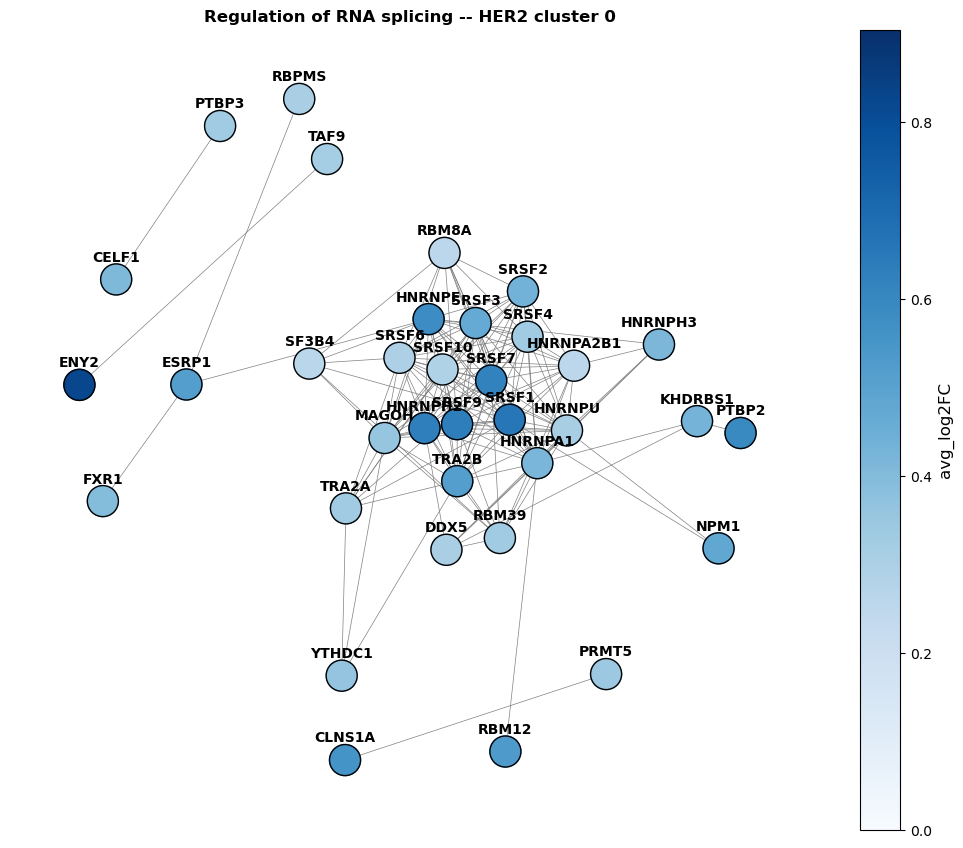

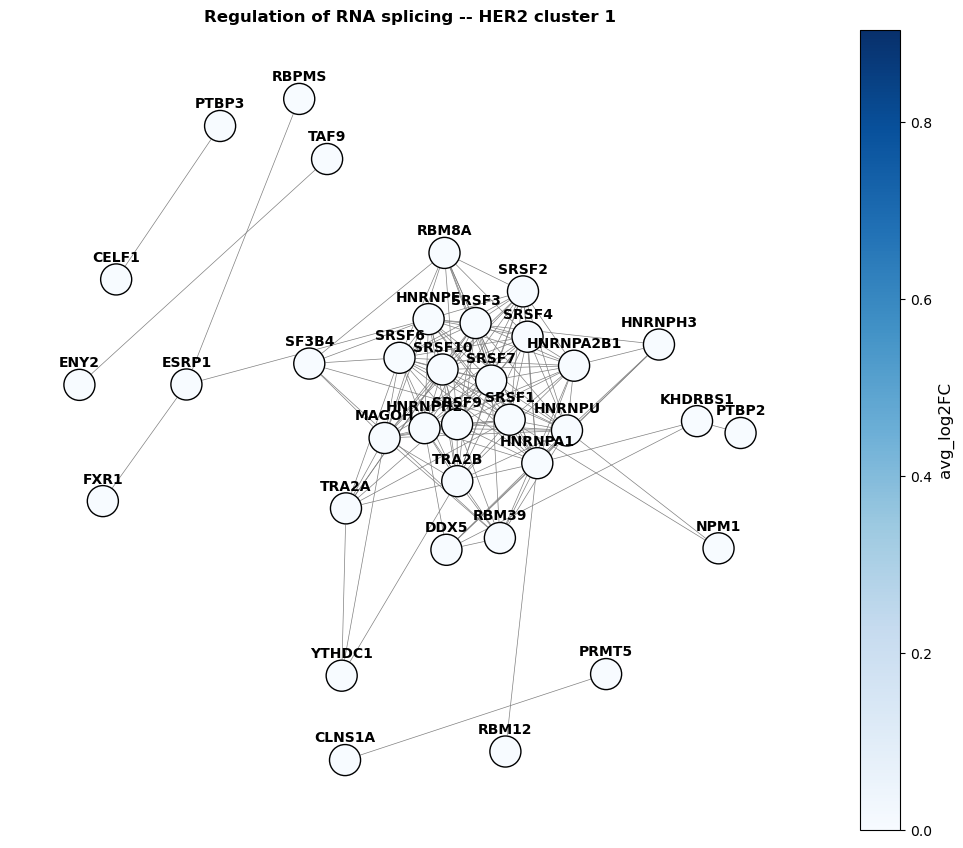

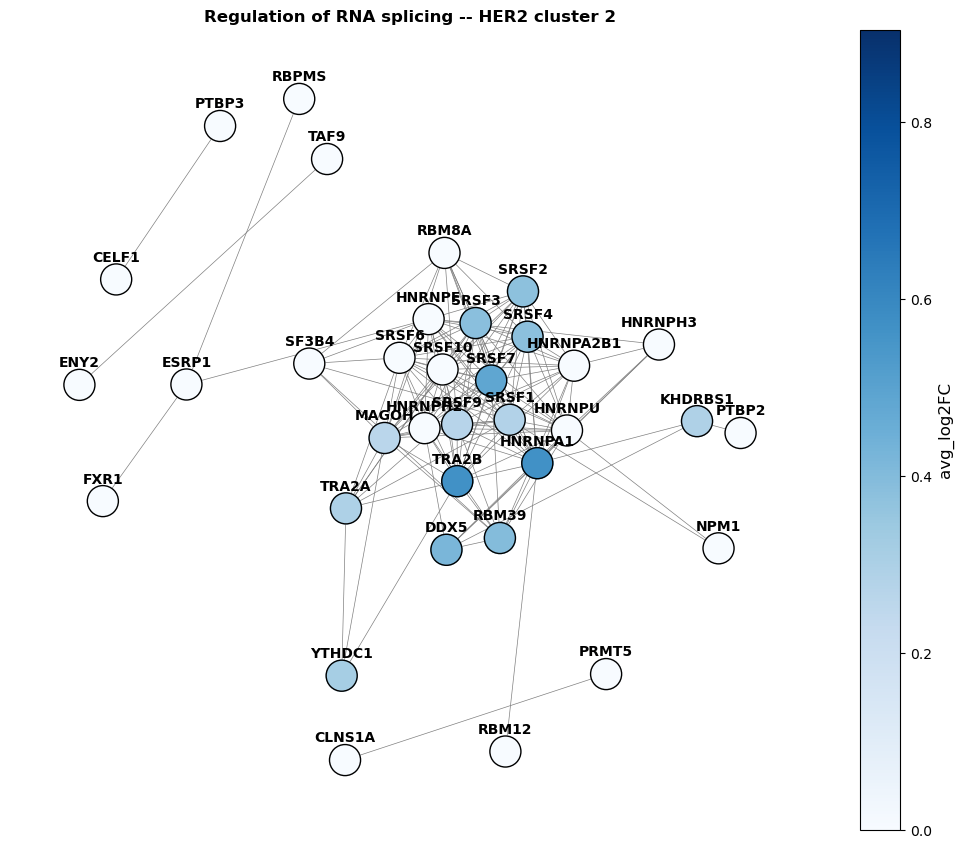

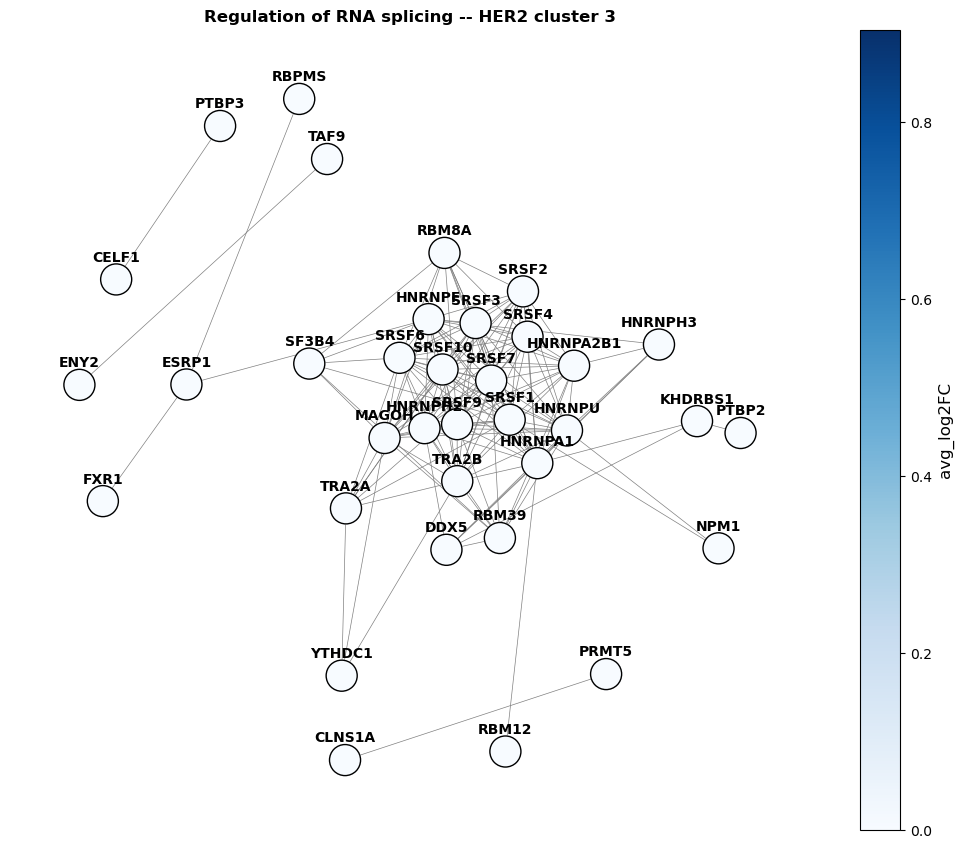

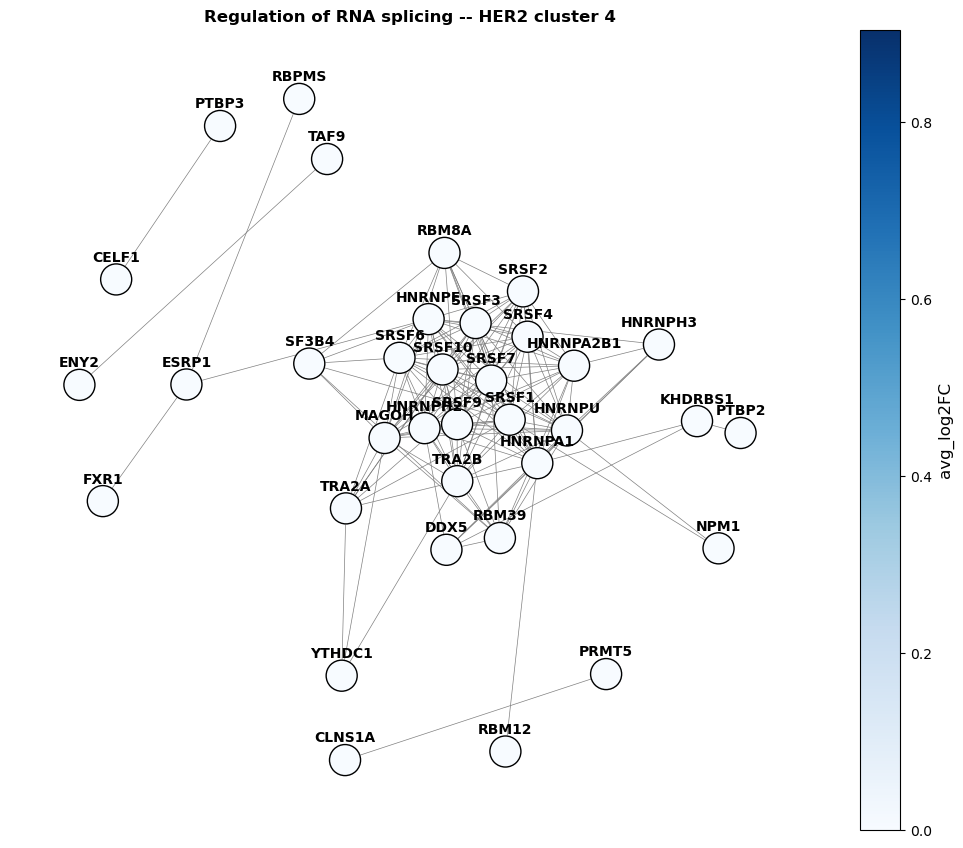

...

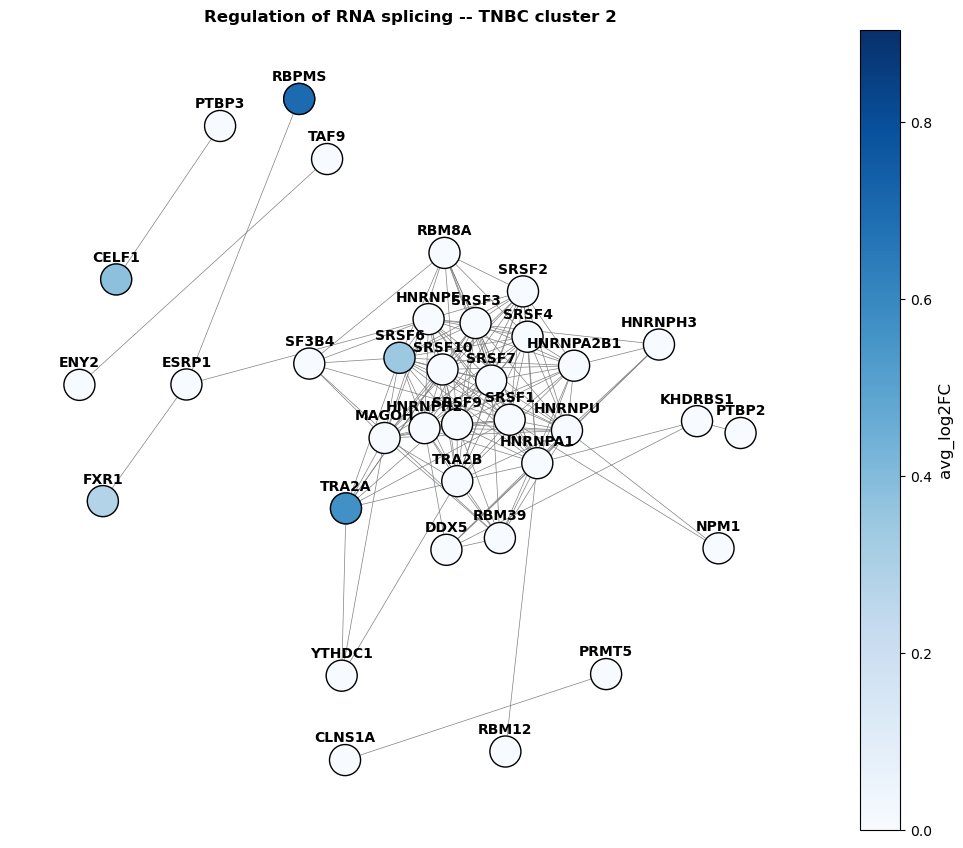

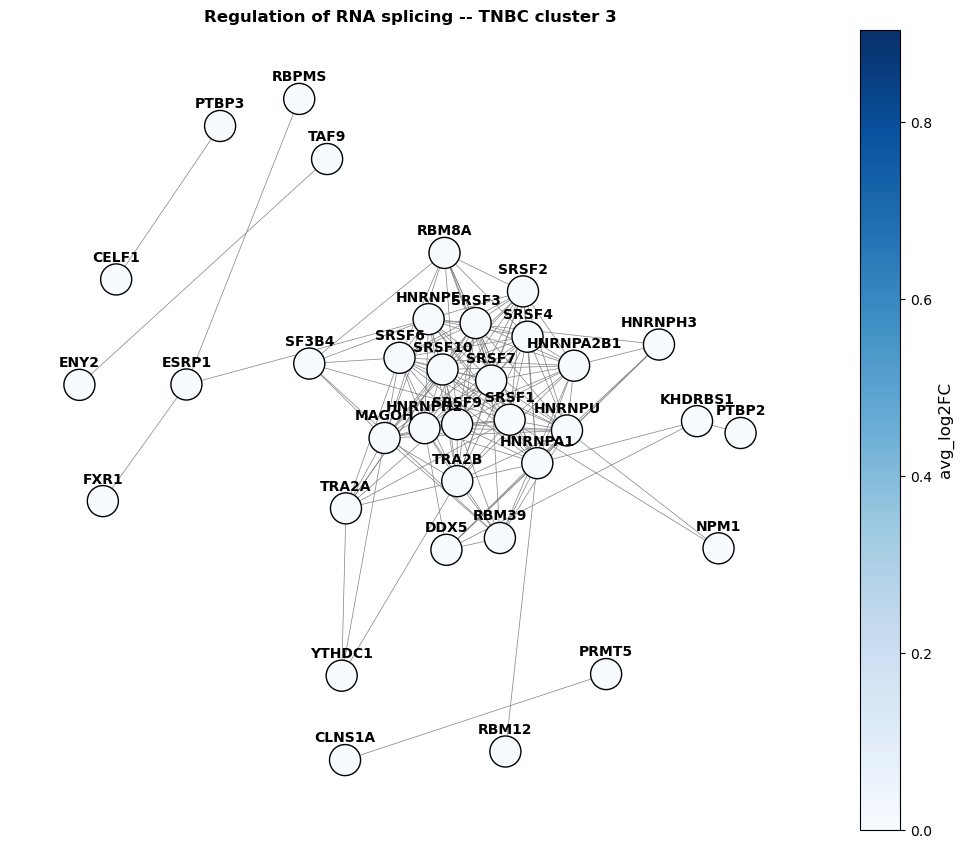

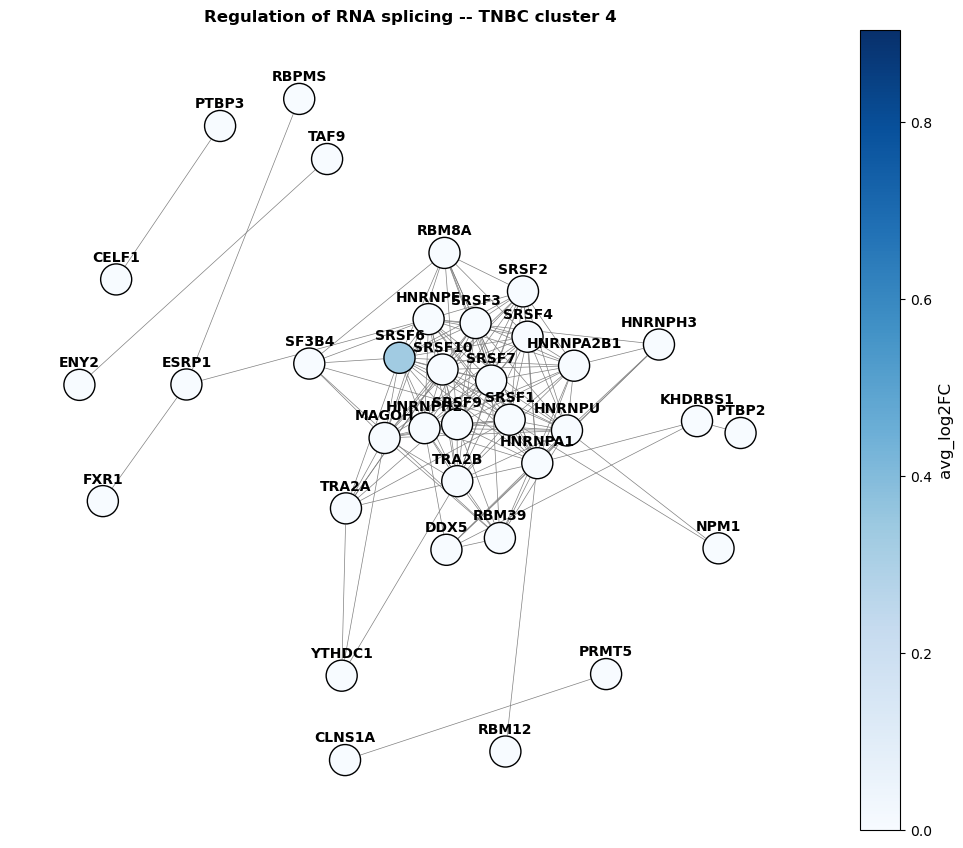

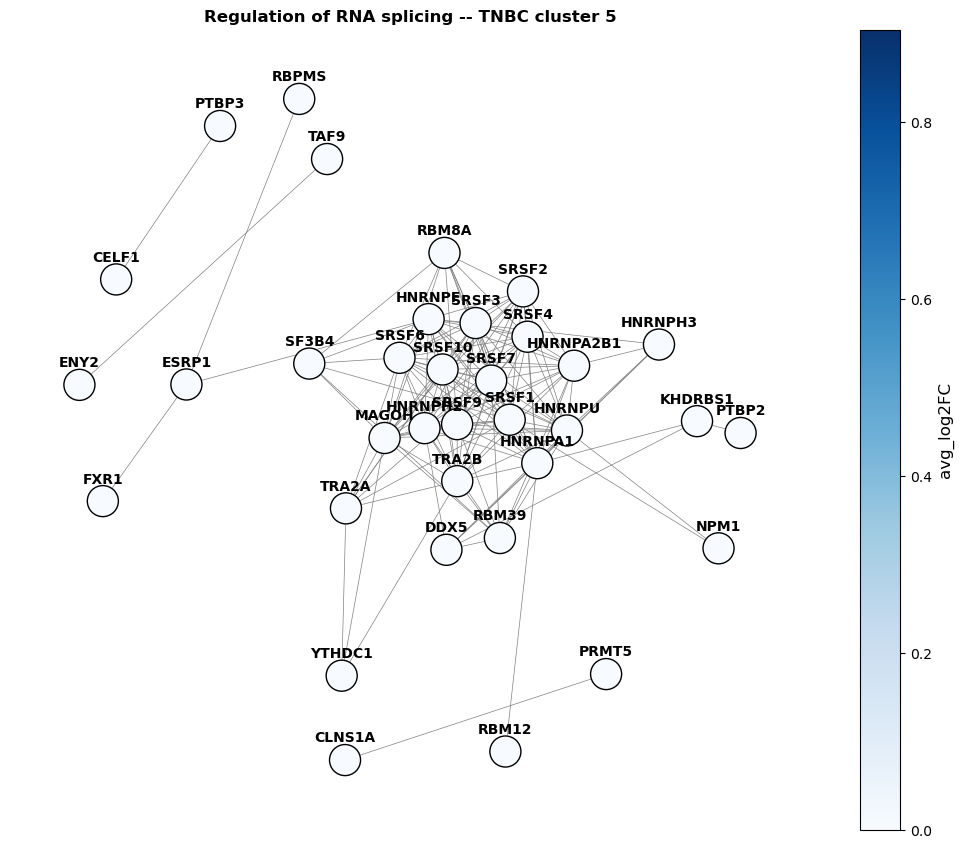

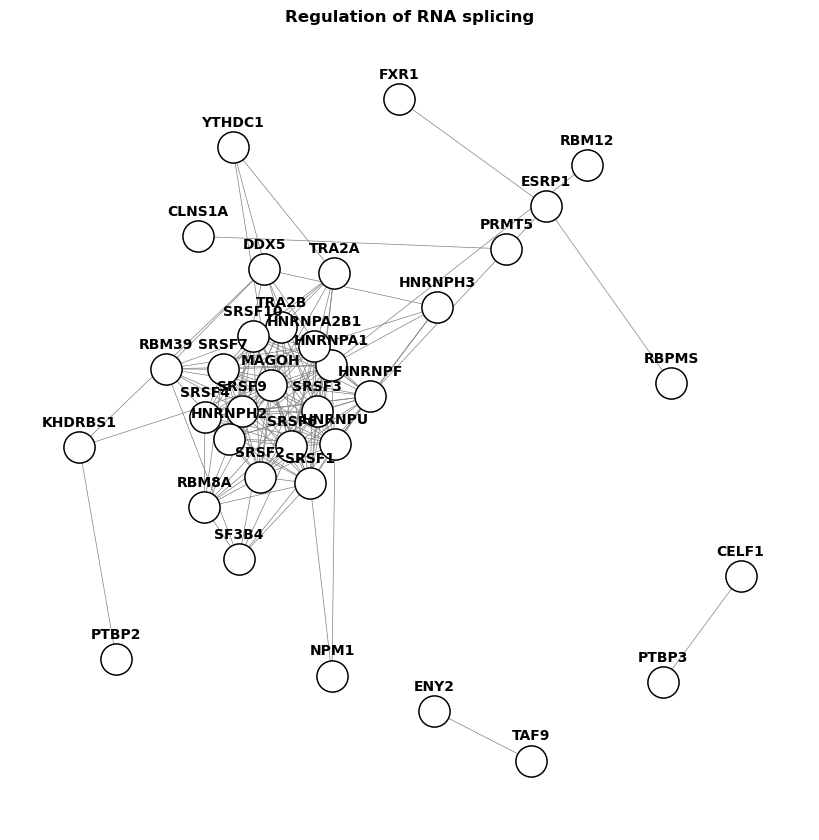

In [7]:
df = pd.read_csv('../../data/pathways/regulation_of_rna_splicing.tsv', sep='\t')
node_list = list(set(df['#node1'].tolist() + df['node2'].tolist()))

vmax = max(markers_T_UNI_TNBC[markers_T_UNI_TNBC['gene'].isin(node_list)].max().loc['avg_log2FC'],
           markers_T_UNI_HER2[markers_T_UNI_HER2['gene'].isin(node_list)].max().loc['avg_log2FC'])

for cluster in range(5):
    pathway_plot_one_cluster(df, node_list, cluster, markers_T_UNI_HER2, vmax=vmax, seed=4, k=1)
    plt.title(f'Regulation of RNA splicing -- HER2 cluster {cluster}', weight='bold')
    plt.savefig(os.path.join(config_HER2["figures_folder"], "Figure5", f'rna_splicing_cluster{cluster}.pdf'), bbox_inches='tight')
    
for cluster in range(6):
    pathway_plot_one_cluster(df, node_list, cluster, markers_T_UNI_TNBC, vmax=vmax, seed=4, k=1)
    plt.title(f'Regulation of RNA splicing -- TNBC cluster {cluster}', weight='bold')
    plt.savefig(os.path.join(config_TNBC["figures_folder"], "Figure5", f'rna_splicing_cluster{cluster}.pdf'), bbox_inches='tight')

pathway_plot_one_cluster(df, node_list, 0, markers_T_UNI_TNBC, color=False)
plt.title('Regulation of RNA splicing', weight='bold')
plt.savefig(os.path.join(config_TNBC["figures_folder"], "Figure5", 'rna_splicing_overall.pdf'), bbox_inches='tight')

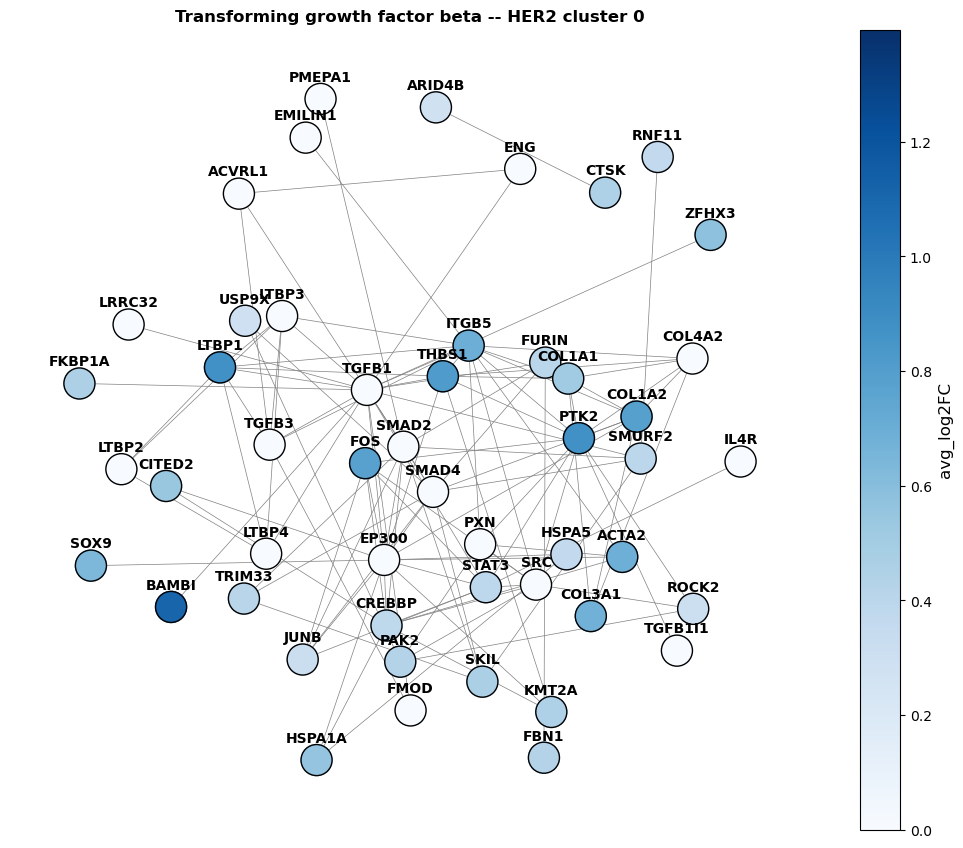

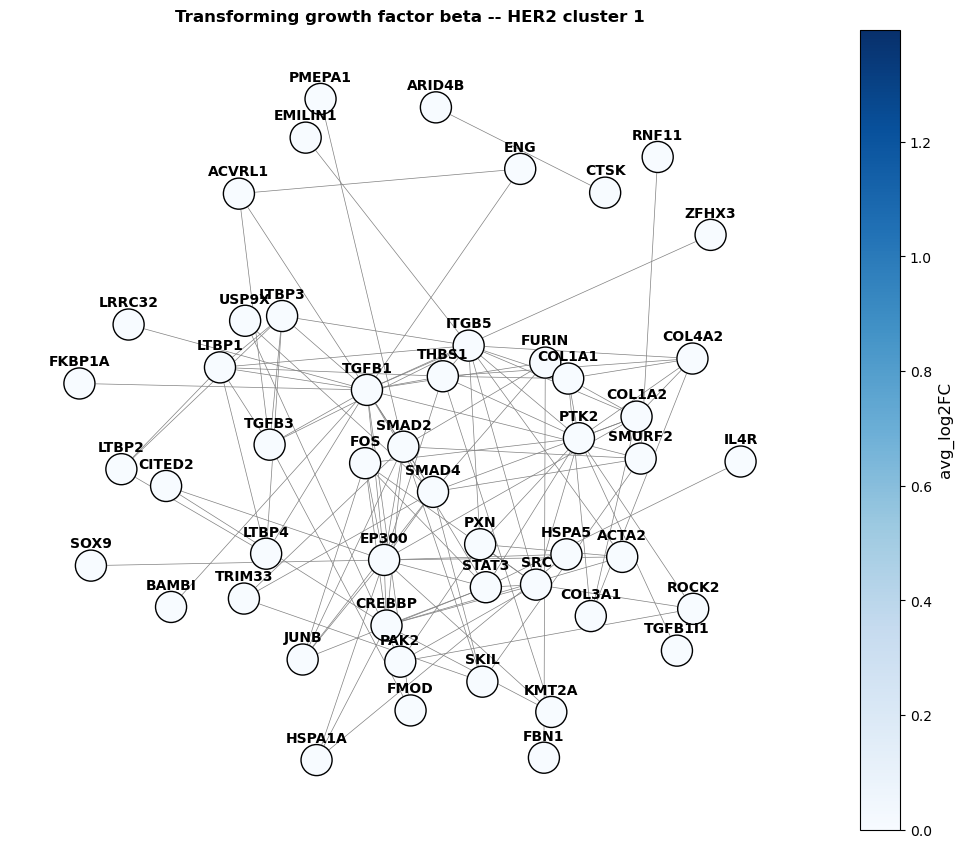

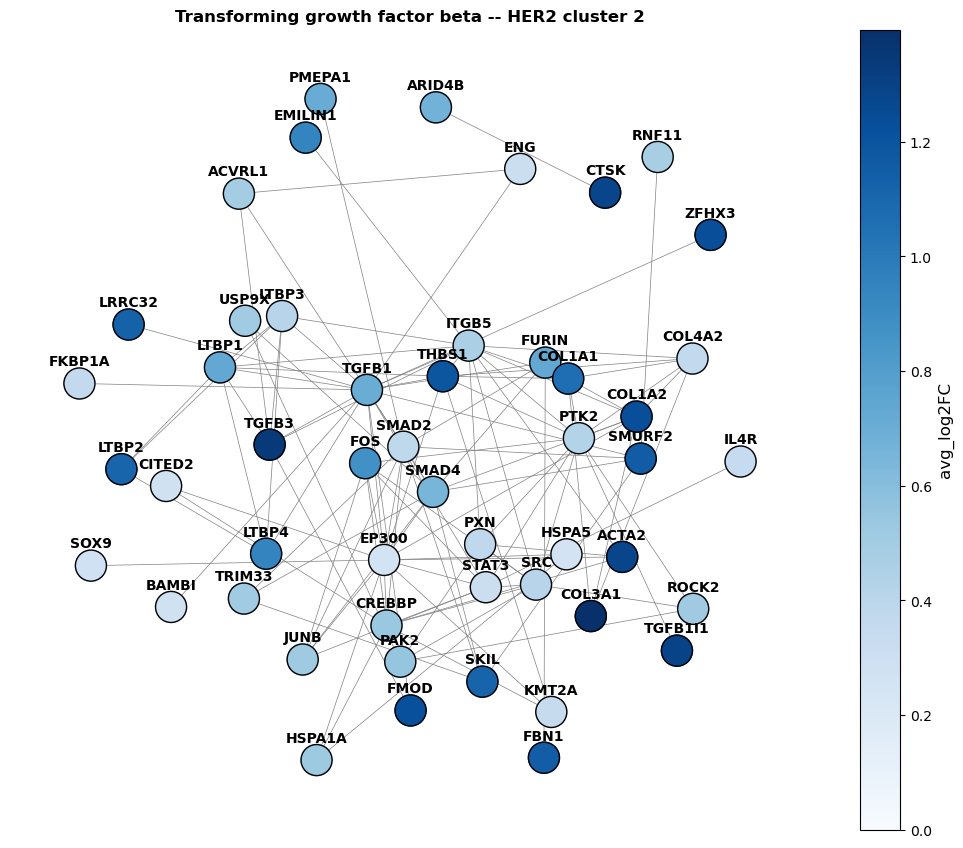

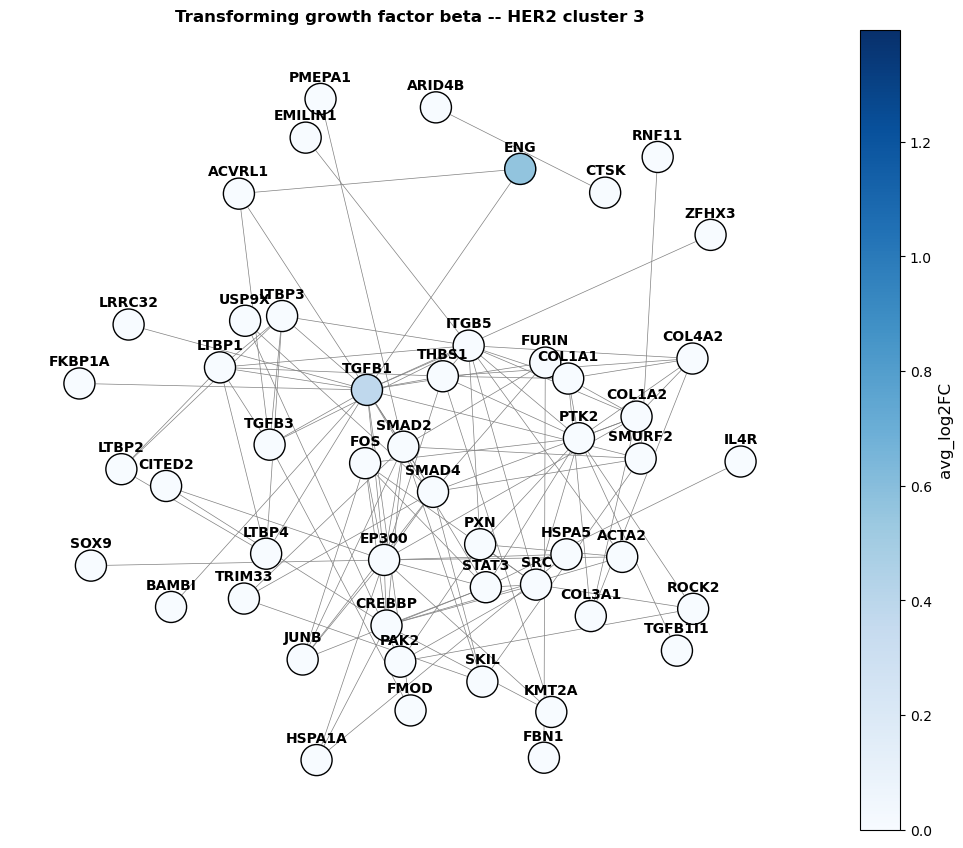

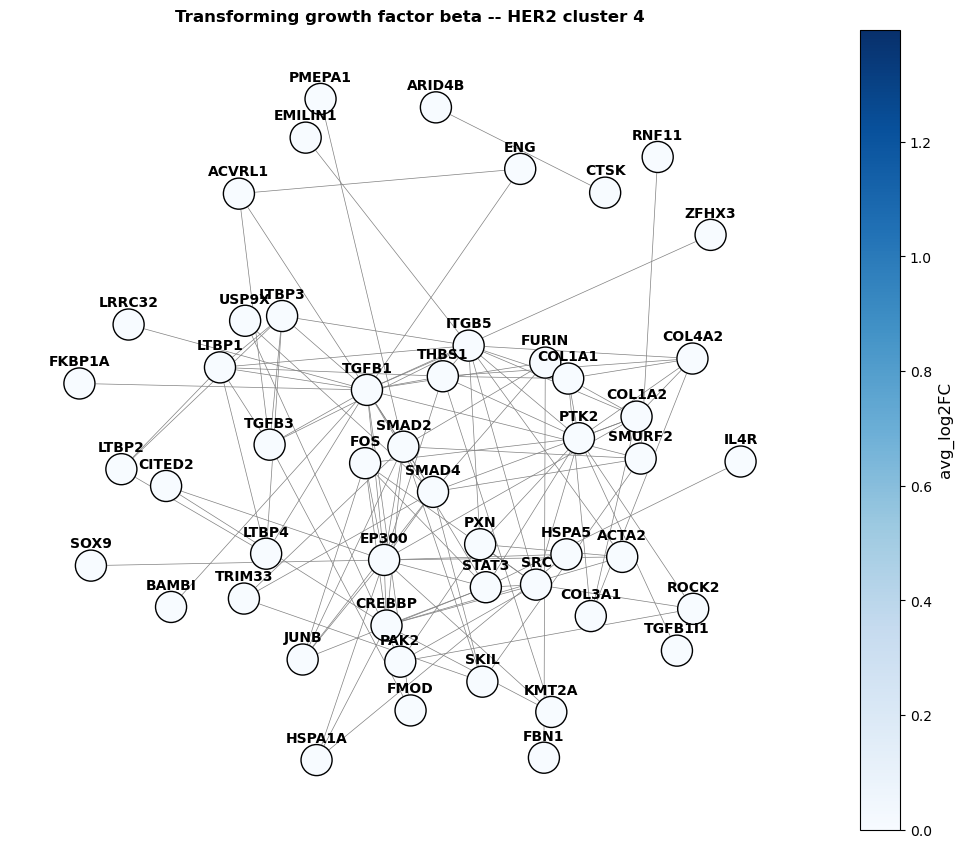

...

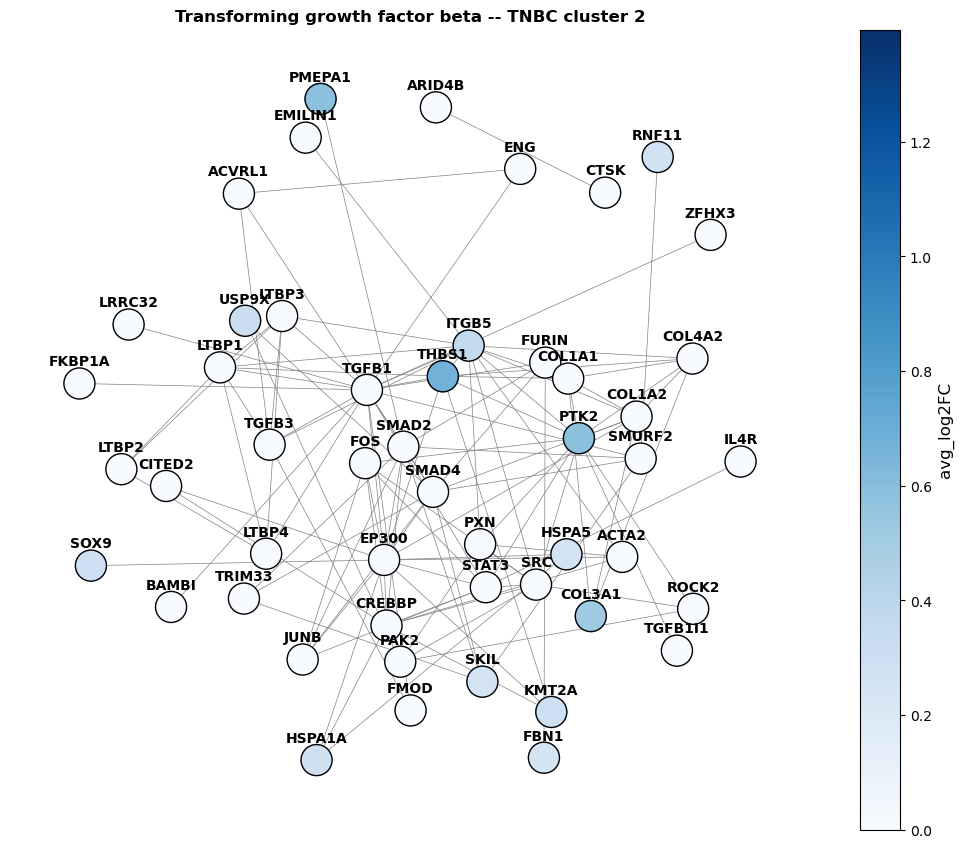

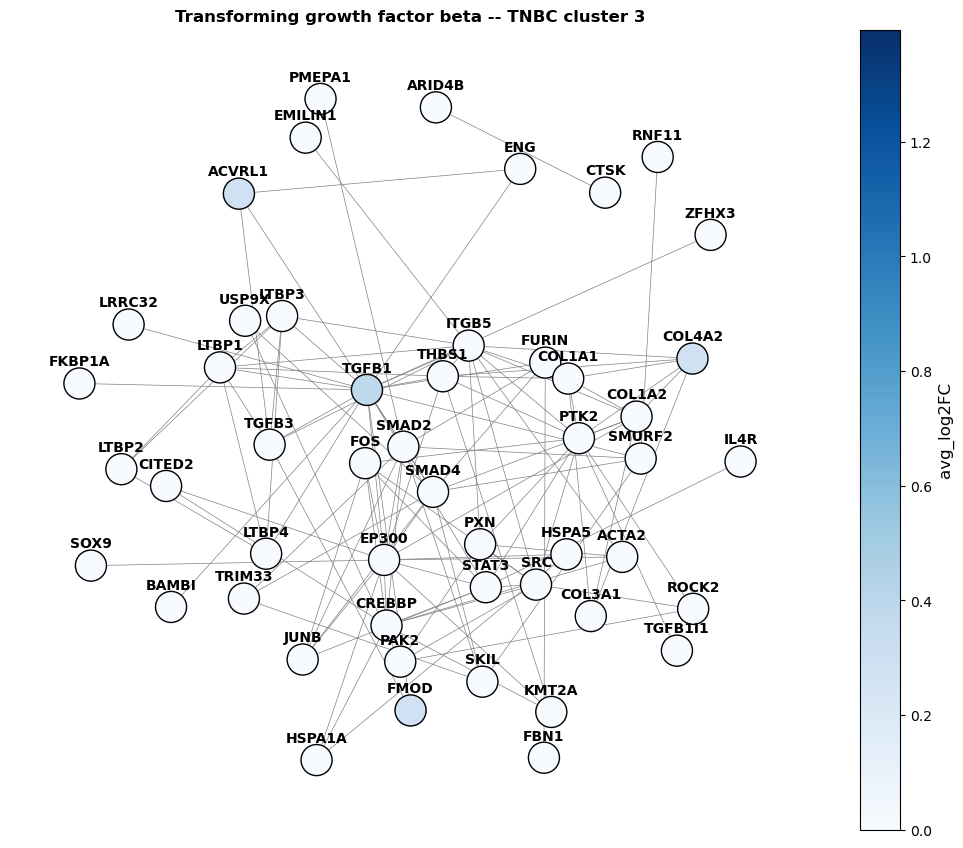

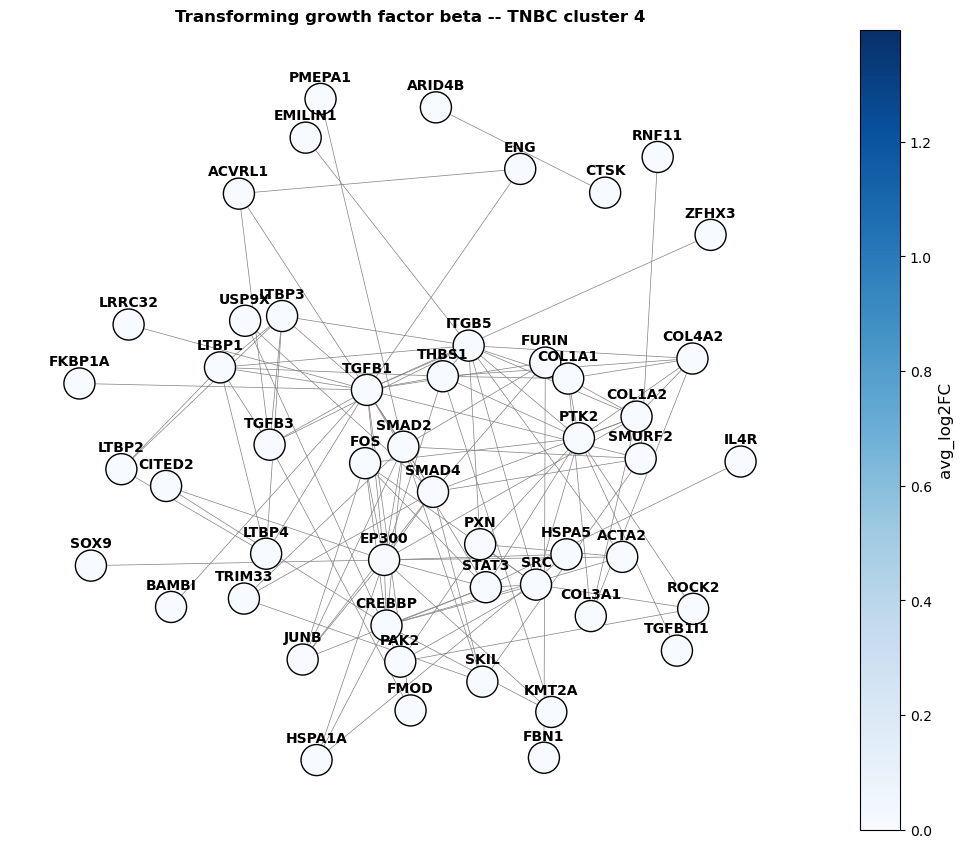

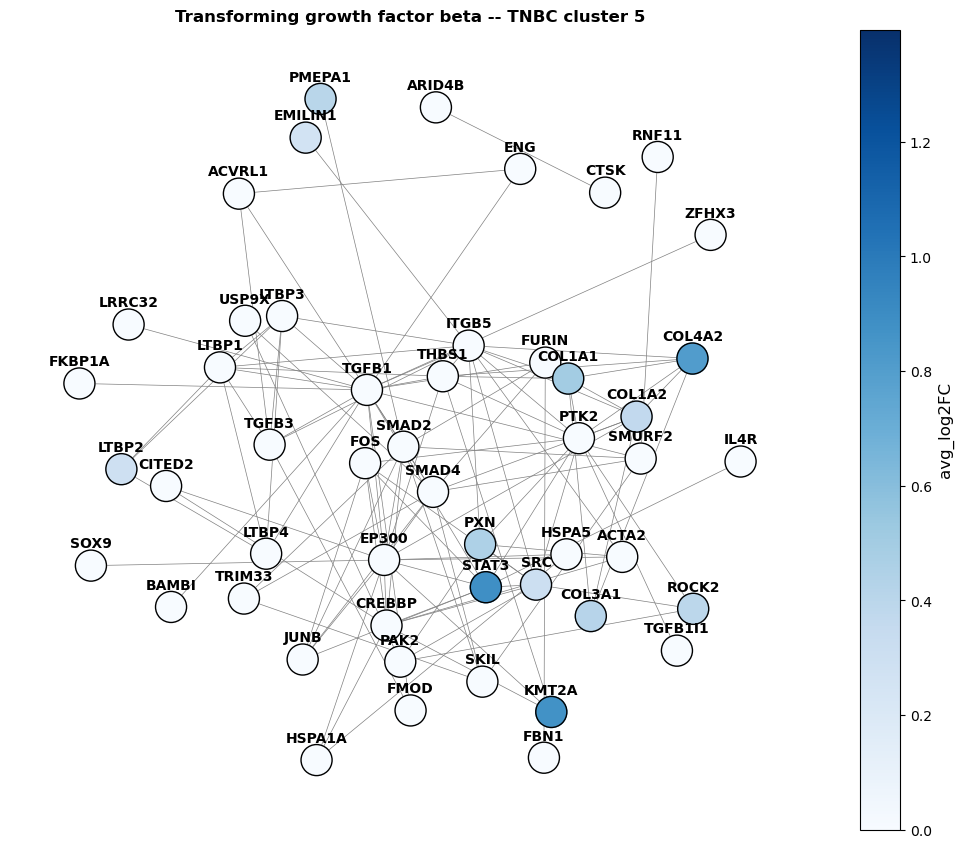

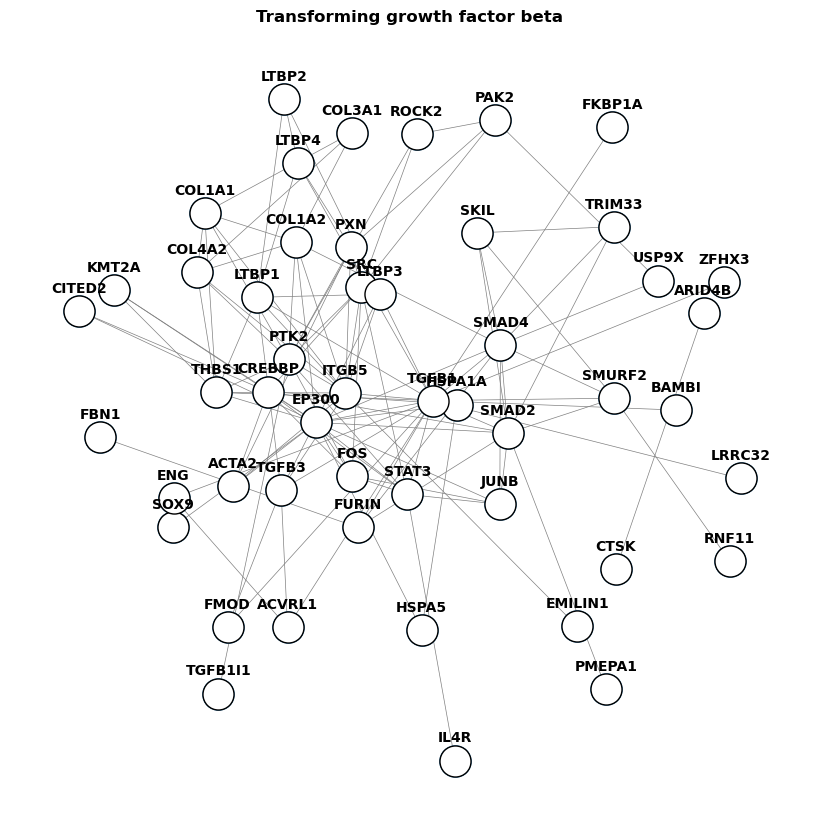

In [8]:
df = pd.read_csv('../../data/pathways/transforming_growth_factor_beta.tsv', sep='\t')
node_list = list(set(df['#node1'].tolist() + df['node2'].tolist()))

vmax = max(markers_T_UNI_TNBC[markers_T_UNI_TNBC['gene'].isin(node_list)].max().loc['avg_log2FC'],
           markers_T_UNI_HER2[markers_T_UNI_HER2['gene'].isin(node_list)].max().loc['avg_log2FC'])

for cluster in range(5):
    pathway_plot_one_cluster(df, node_list, cluster, markers_T_UNI_HER2, vmax=vmax, seed=4, k=1)
    plt.title(f'Transforming growth factor beta -- HER2 cluster {cluster}', weight='bold')
    plt.savefig(os.path.join(config_HER2["figures_folder"], "Figure5", f'transforming_growth_factor_beta_cluster{cluster}.pdf'), bbox_inches='tight')
    
for cluster in range(6):
    pathway_plot_one_cluster(df, node_list, cluster, markers_T_UNI_TNBC, vmax=vmax, seed=4, k=1)
    plt.title(f'Transforming growth factor beta -- TNBC cluster {cluster}', weight='bold')
    plt.savefig(os.path.join(config_TNBC["figures_folder"], "Figure5", f'transforming_growth_factor_beta_cluster{cluster}.pdf'), bbox_inches='tight')

pathway_plot_one_cluster(df, node_list, 0, markers_T_UNI_TNBC, color=False)
plt.title('Transforming growth factor beta', weight='bold')
plt.savefig(os.path.join(config_TNBC["figures_folder"], "Figure5", 'transforming_growth_factor_beta_overall.pdf'), bbox_inches='tight')

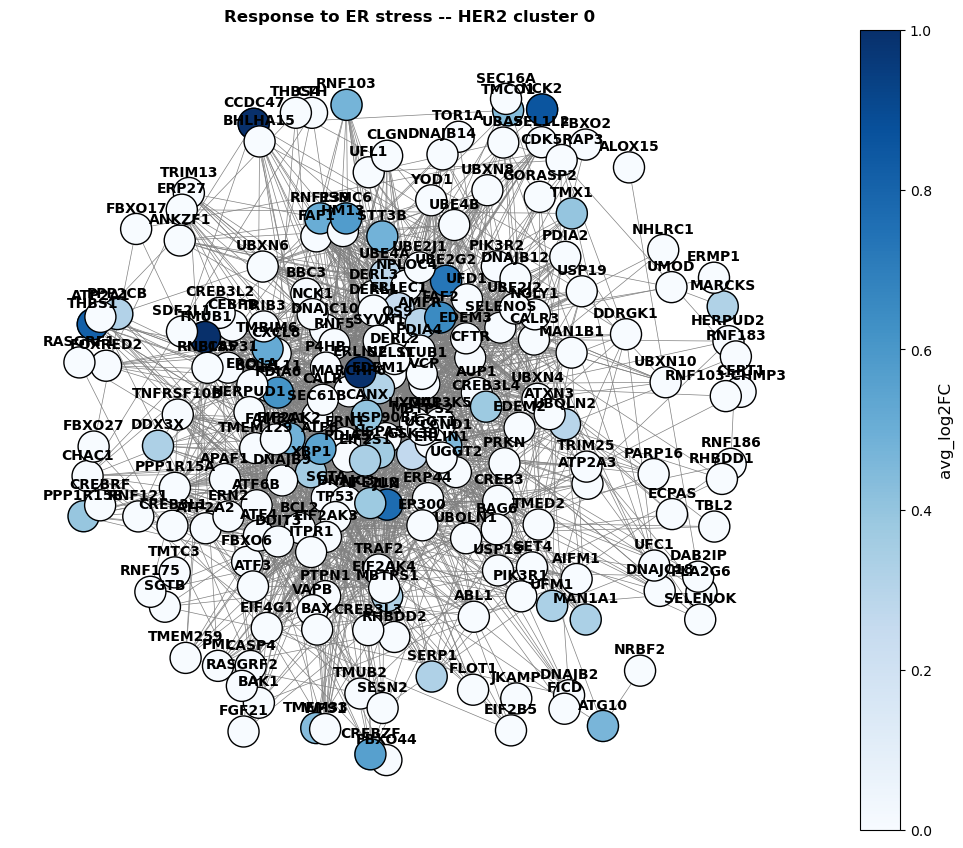

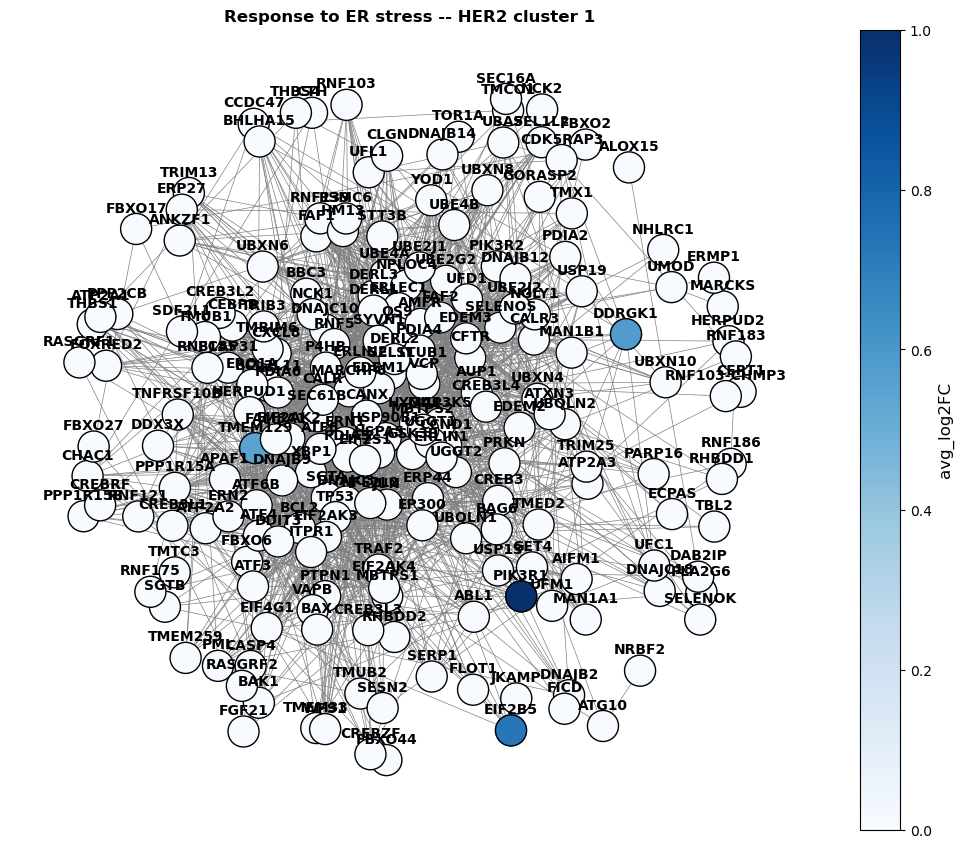

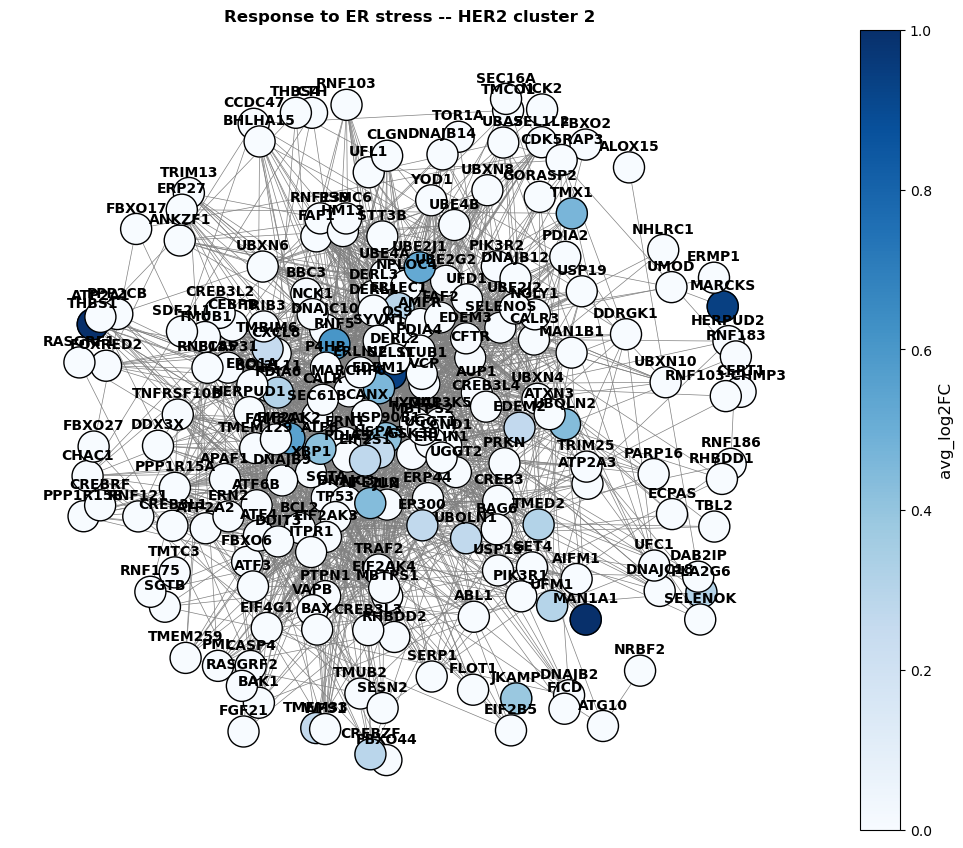

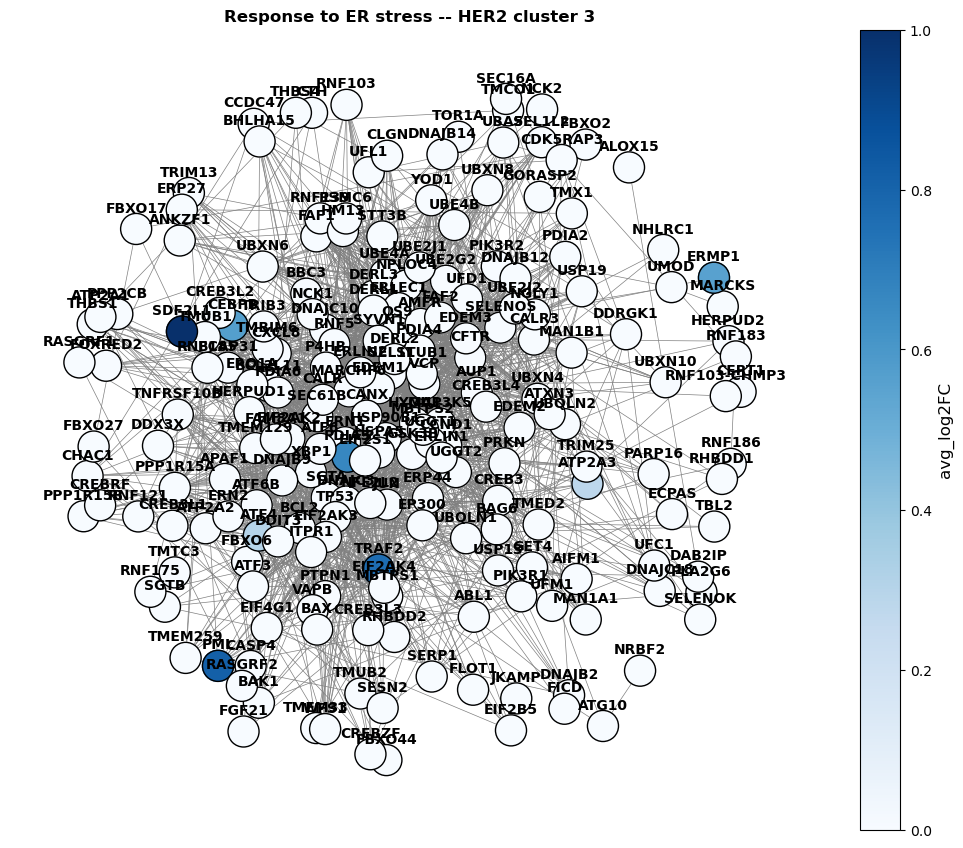

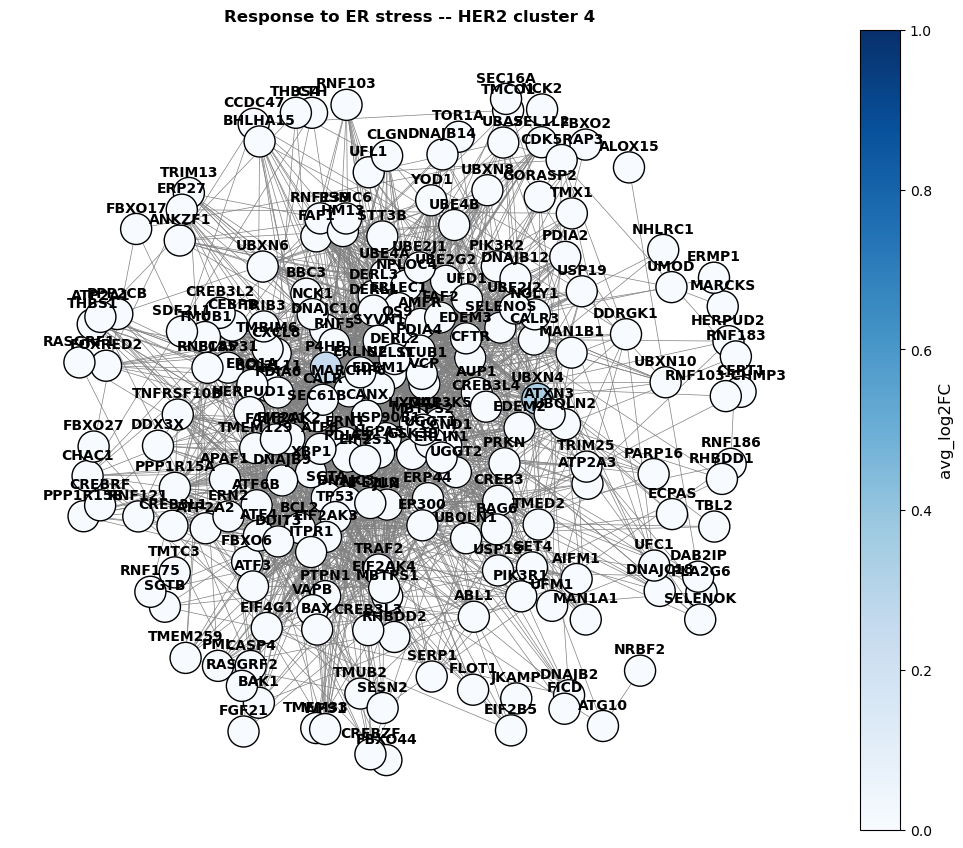

...

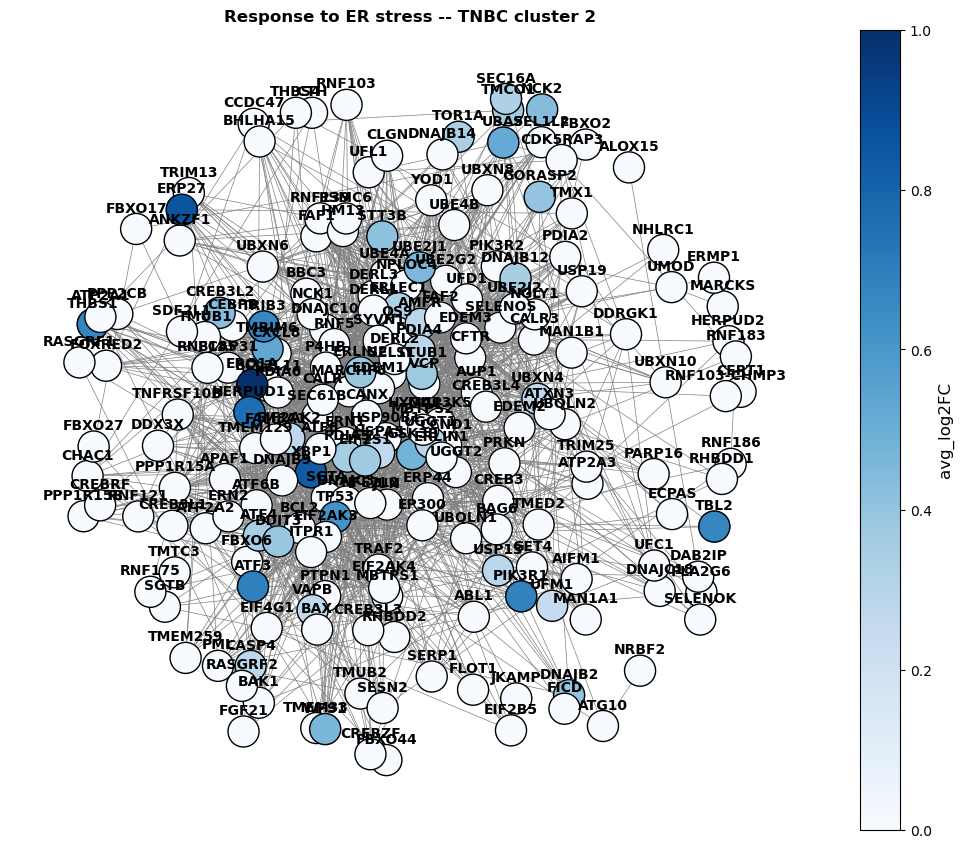

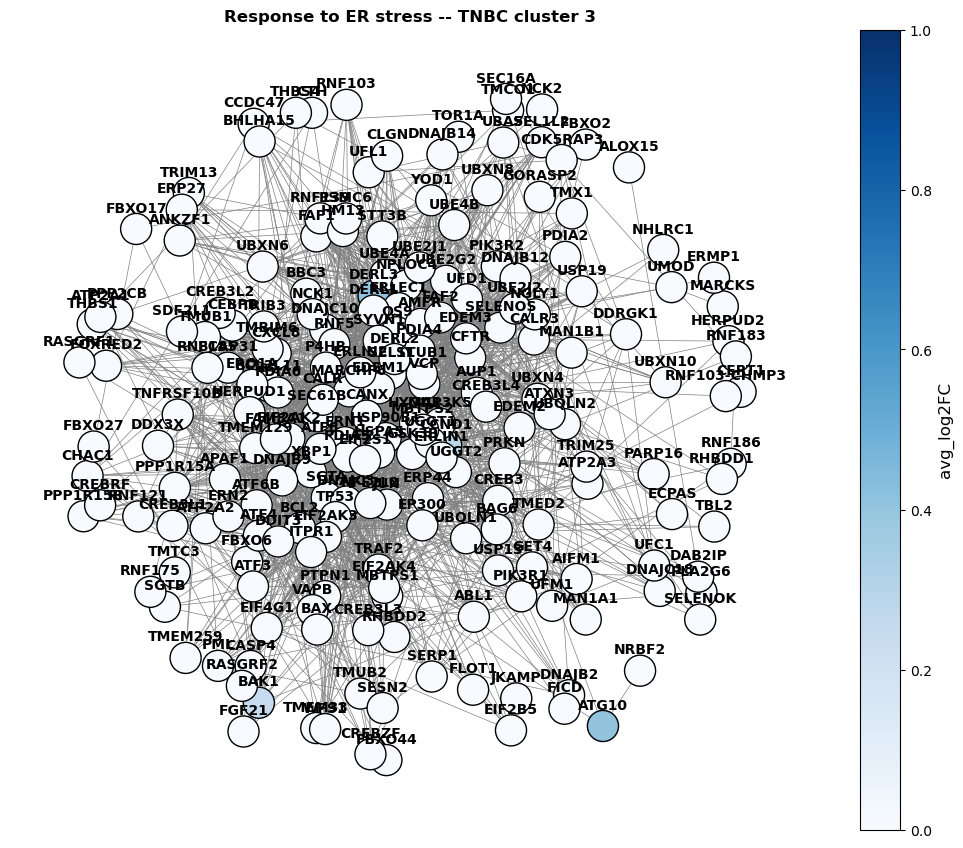

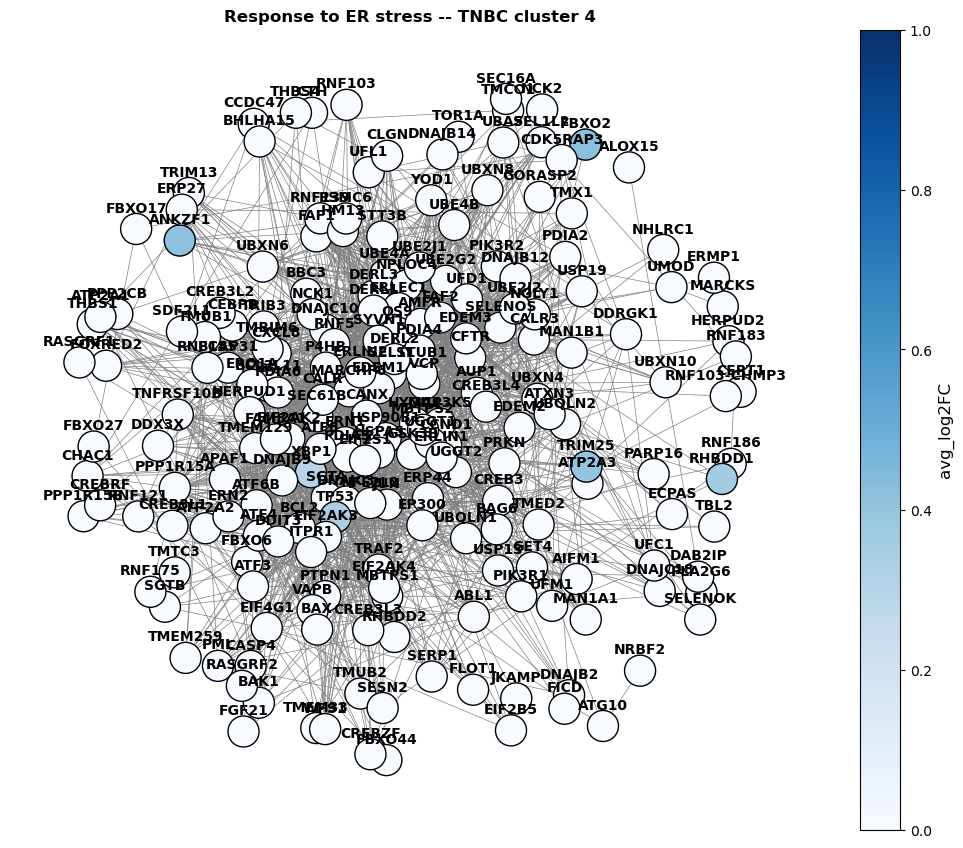

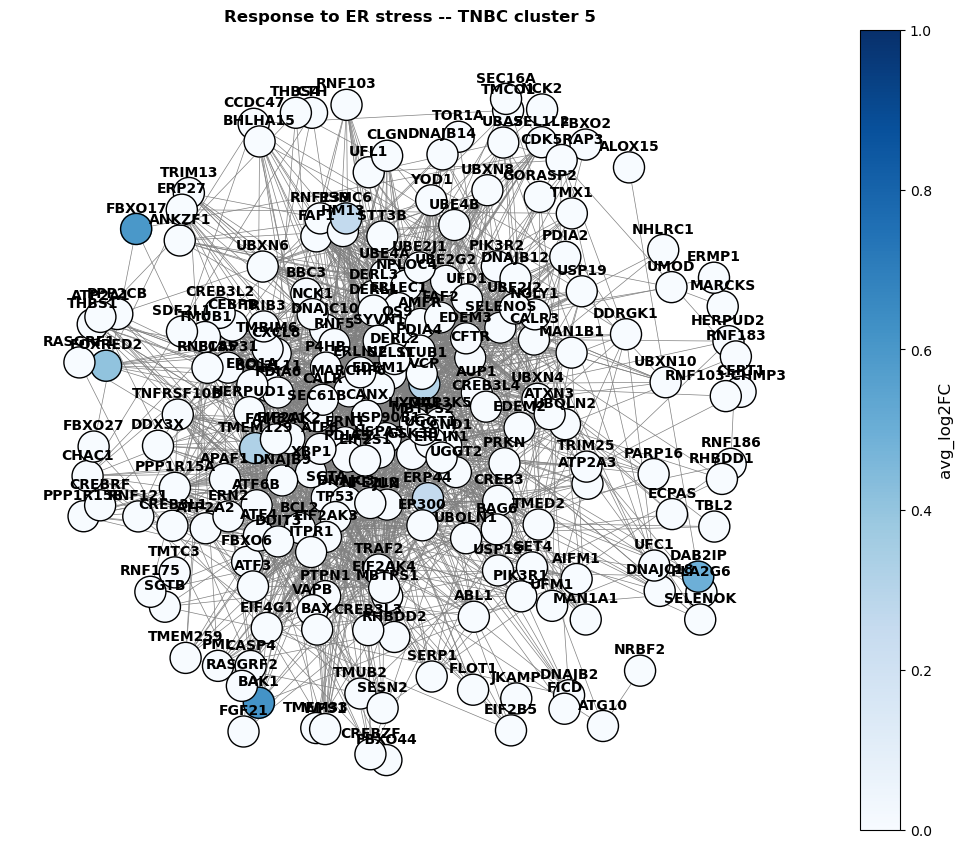

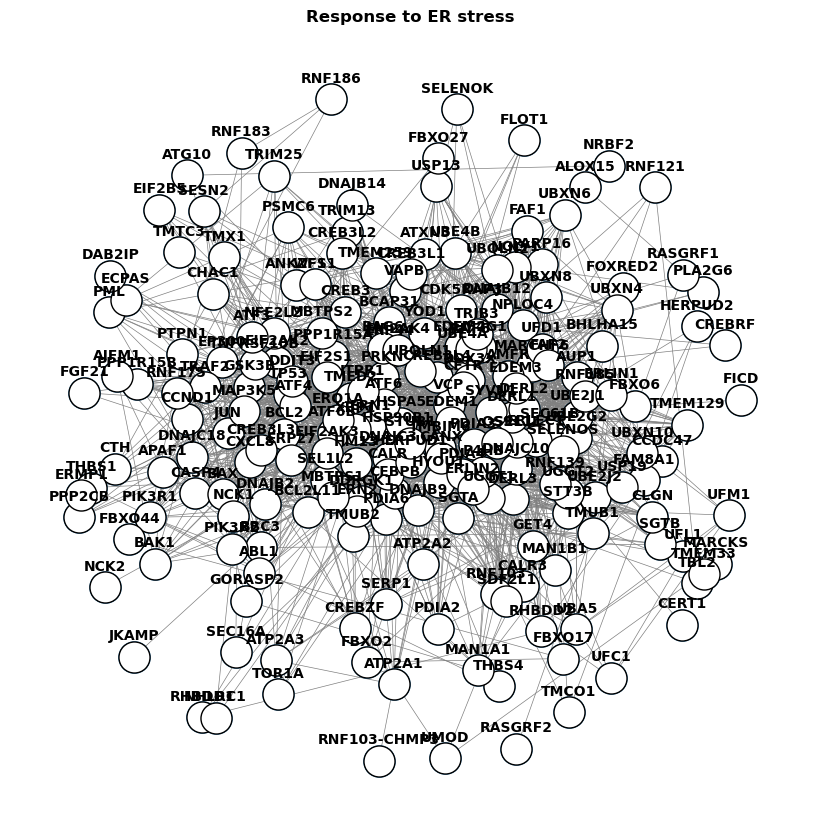

In [9]:
df = pd.read_csv('../../data/pathways/response_to_ER_stress.tsv', sep='\t')
node_list = list(set(df['#node1'].tolist() + df['node2'].tolist()))

vmax = max(markers_T_UNI_TNBC[markers_T_UNI_TNBC['gene'].isin(node_list)].max().loc['avg_log2FC'],
           markers_T_UNI_HER2[markers_T_UNI_HER2['gene'].isin(node_list)].max().loc['avg_log2FC'])

for cluster in range(5):
    pathway_plot_one_cluster(df, node_list, cluster, markers_T_UNI_HER2, vmax=1, seed=4, k=1)
    plt.title(f'Response to ER stress -- HER2 cluster {cluster}', weight='bold')
    plt.savefig(os.path.join(config_HER2["figures_folder"], "Figure5", f'response_to_ER_stress_cluster{cluster}.pdf'), bbox_inches='tight')
    
for cluster in range(6):
    pathway_plot_one_cluster(df, node_list, cluster, markers_T_UNI_TNBC, vmax=1, seed=4, k=1)
    plt.title(f'Response to ER stress -- TNBC cluster {cluster}', weight='bold')
    plt.savefig(os.path.join(config_TNBC["figures_folder"], "Figure5", f'response_to_ER_stress_cluster{cluster}.pdf'), bbox_inches='tight')

pathway_plot_one_cluster(df, node_list, 0, markers_T_UNI_TNBC, color=False)
plt.title('Response to ER stress', weight='bold')
plt.savefig(os.path.join(config_TNBC["figures_folder"], "Figure5", 'response_to_ER_stress_overall.pdf'), bbox_inches='tight')

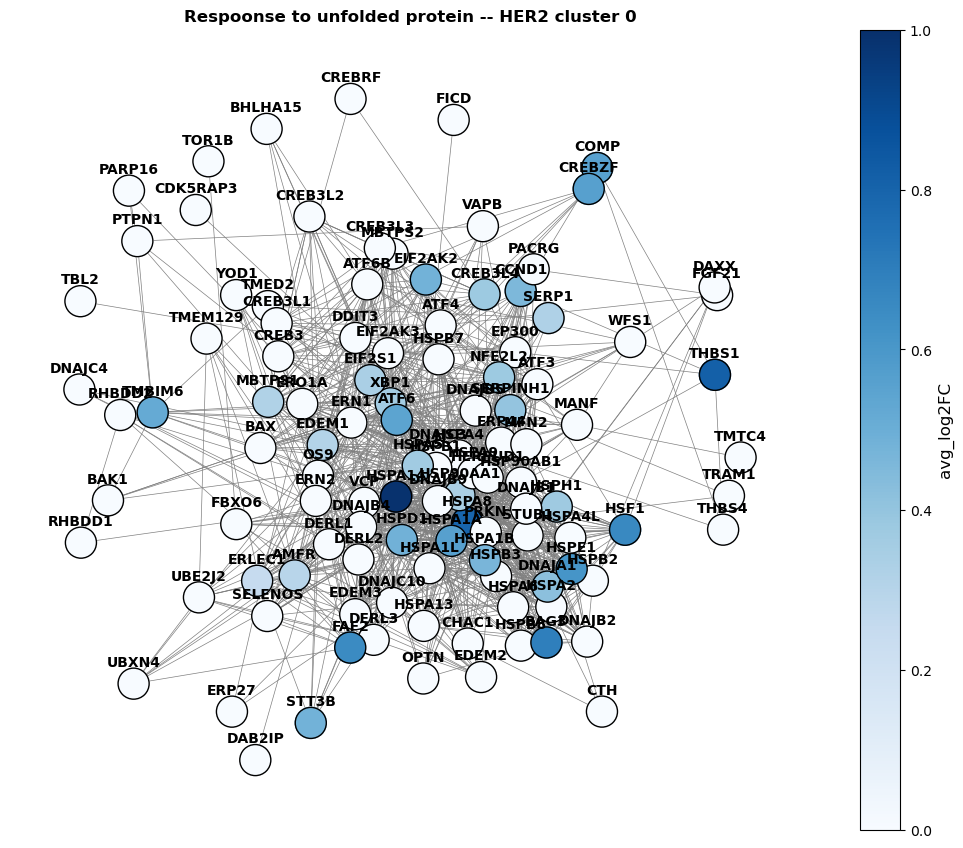

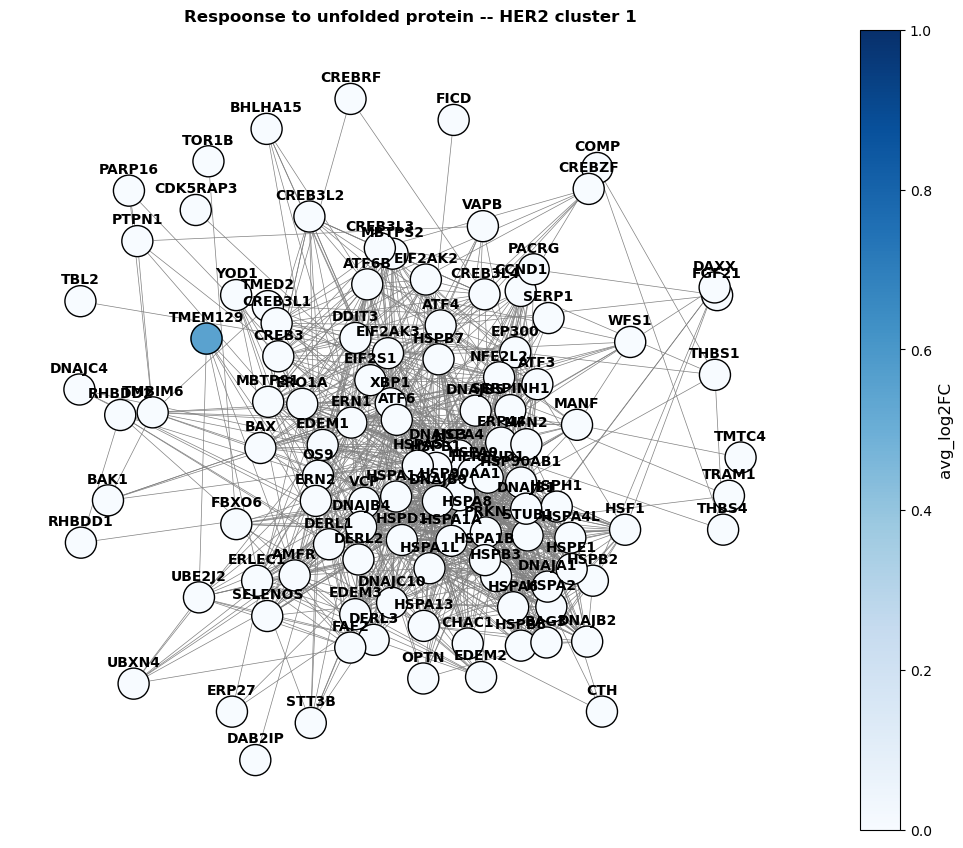

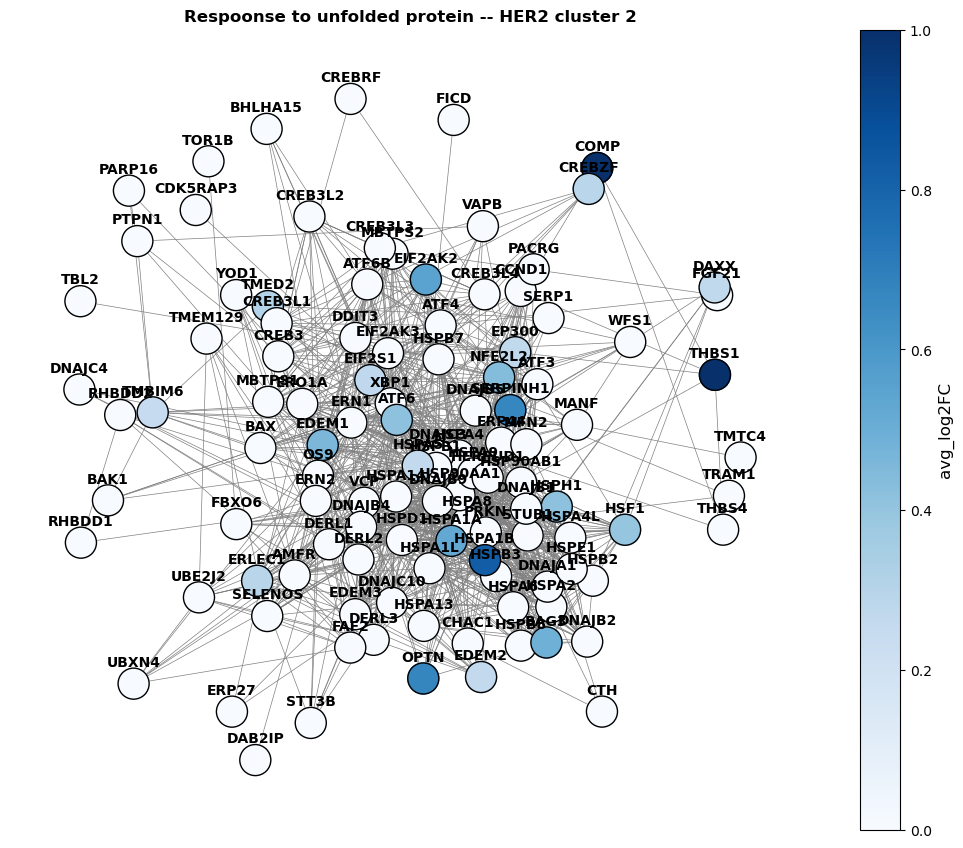

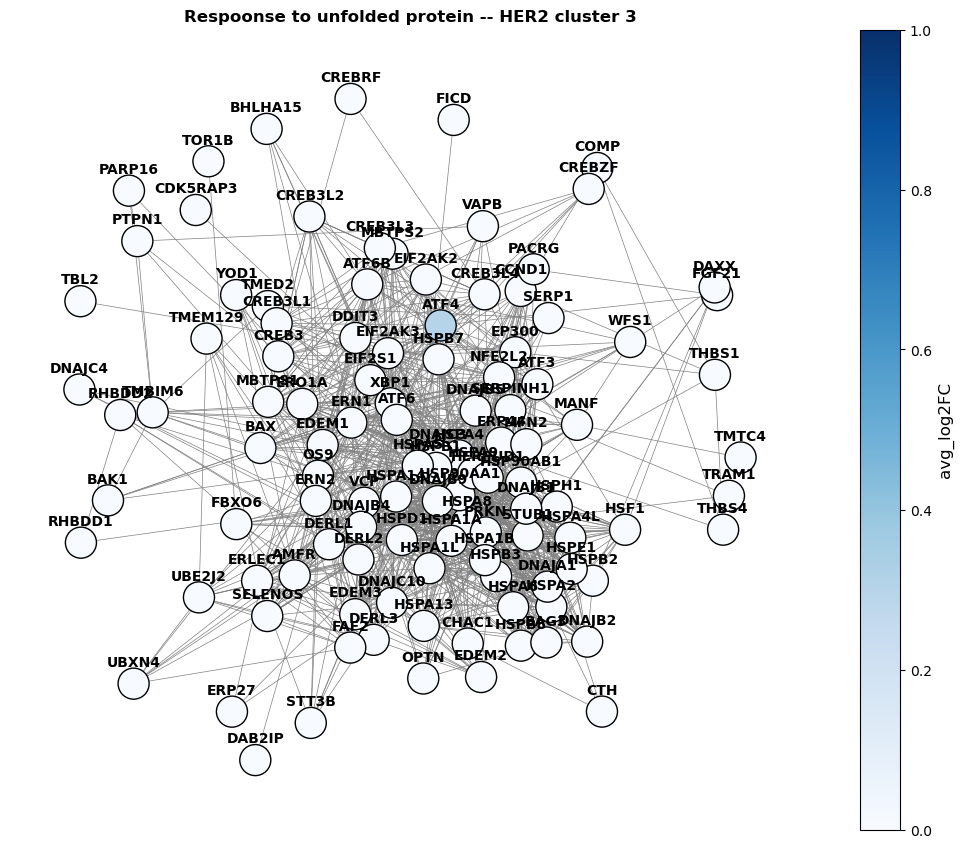

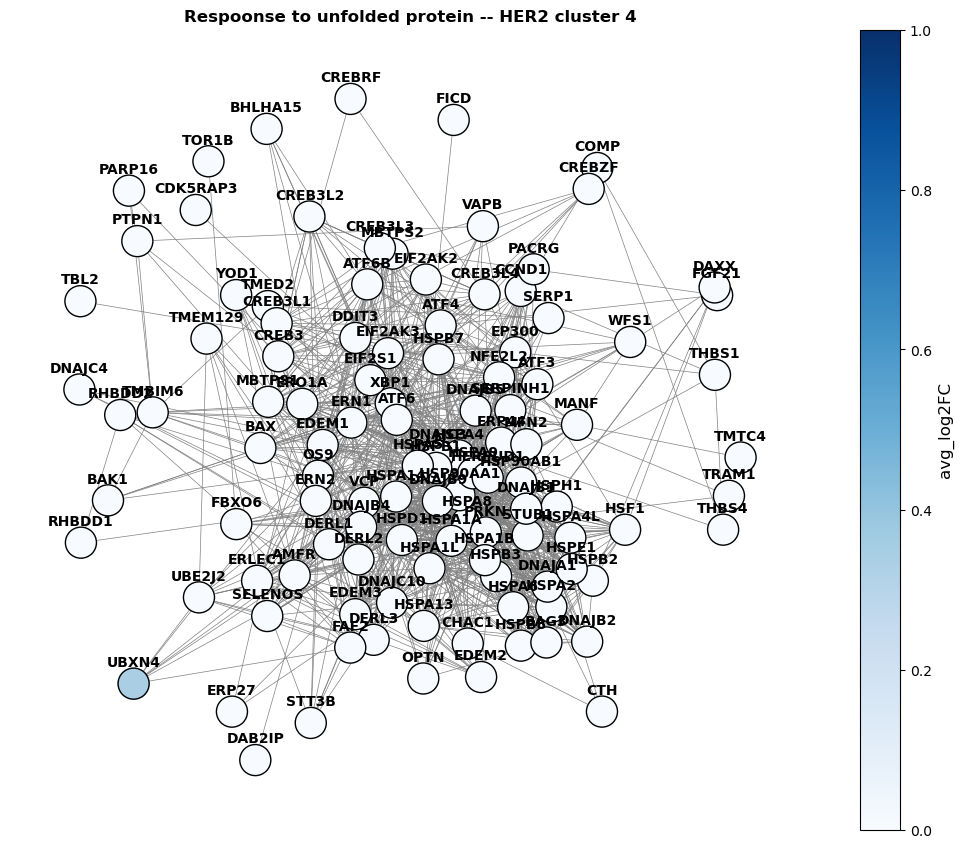

...

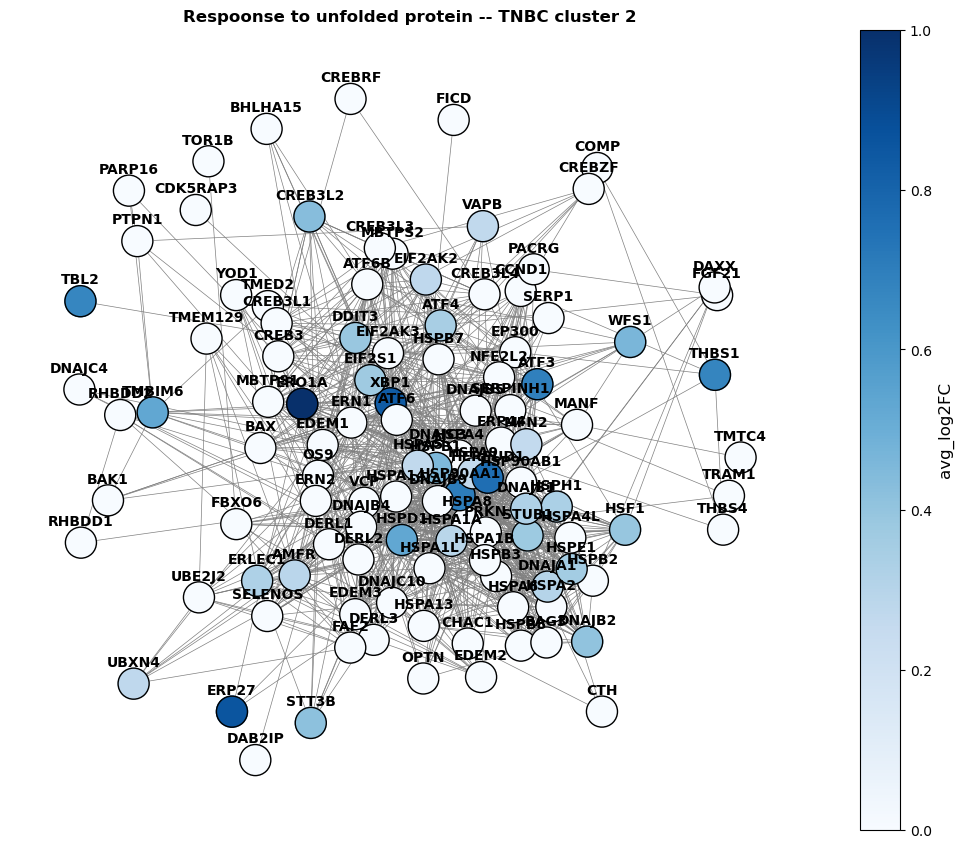

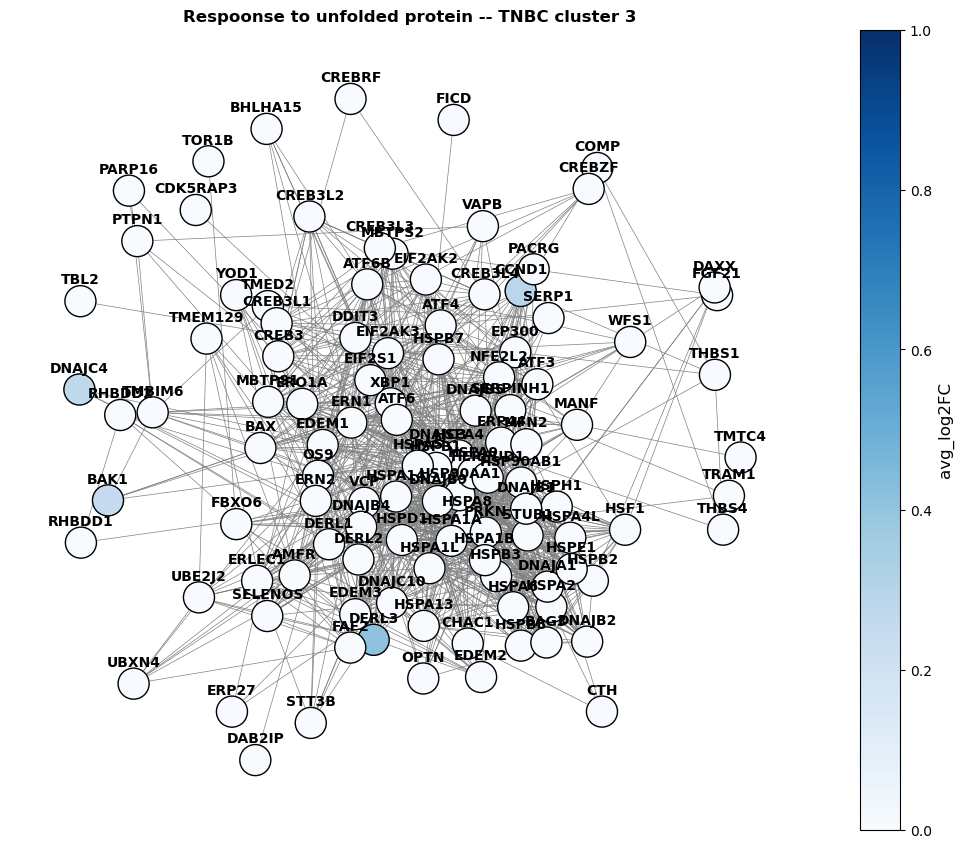

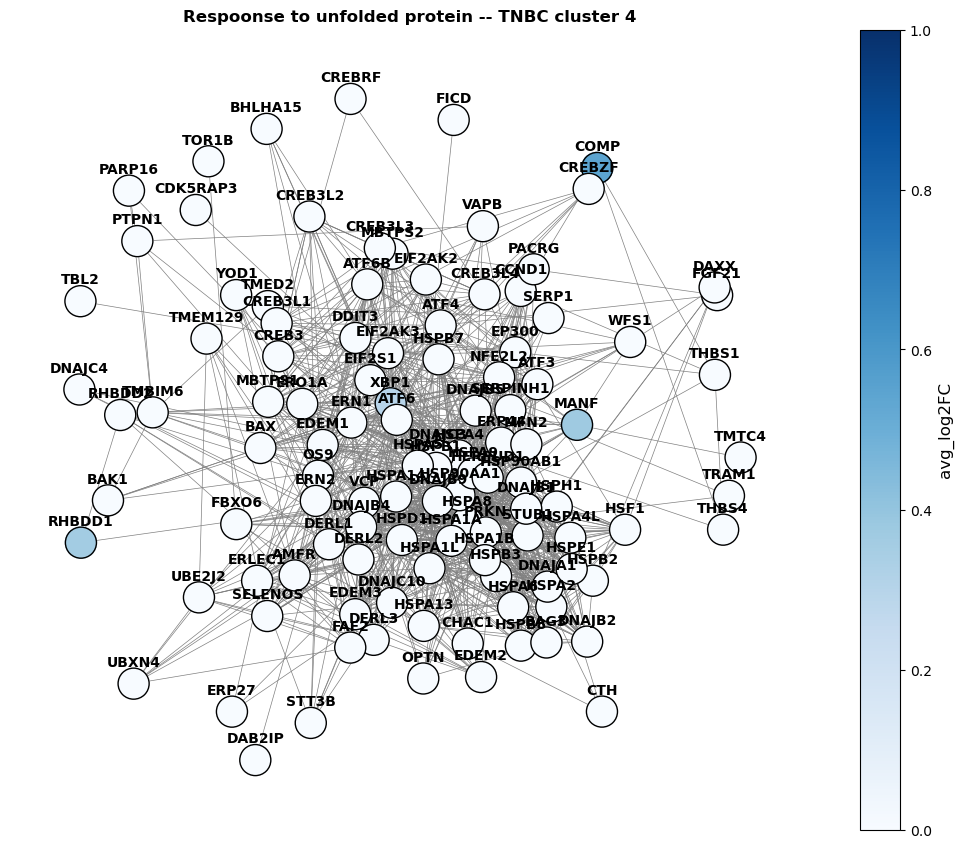

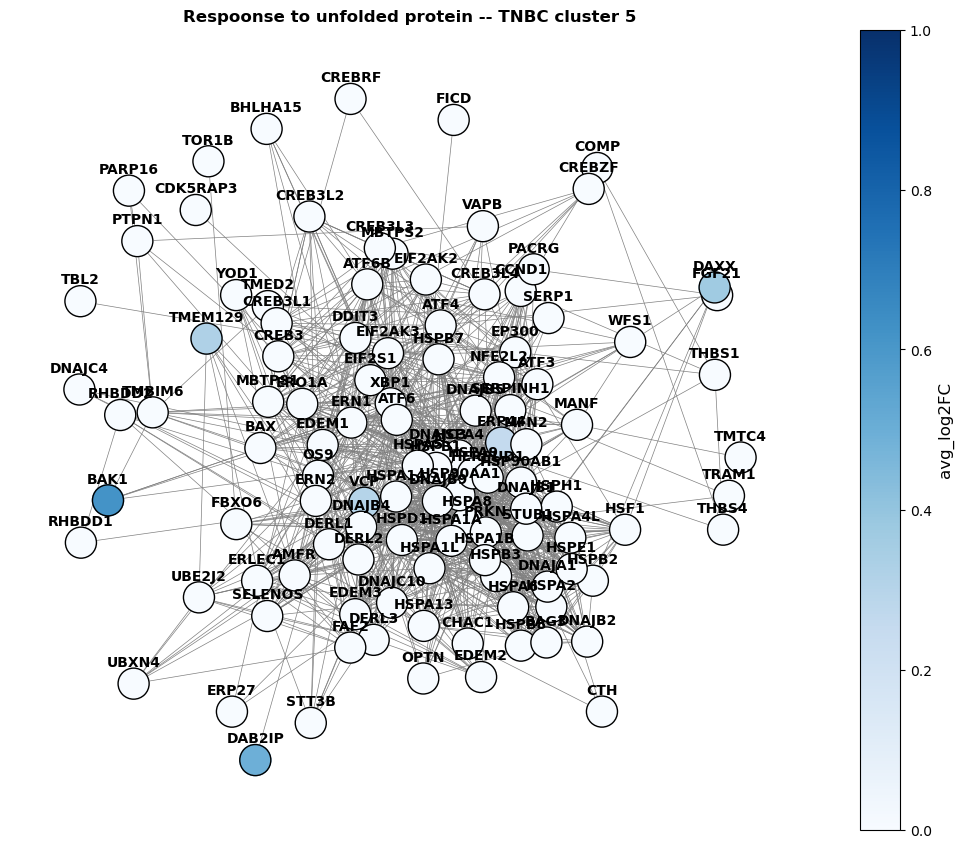

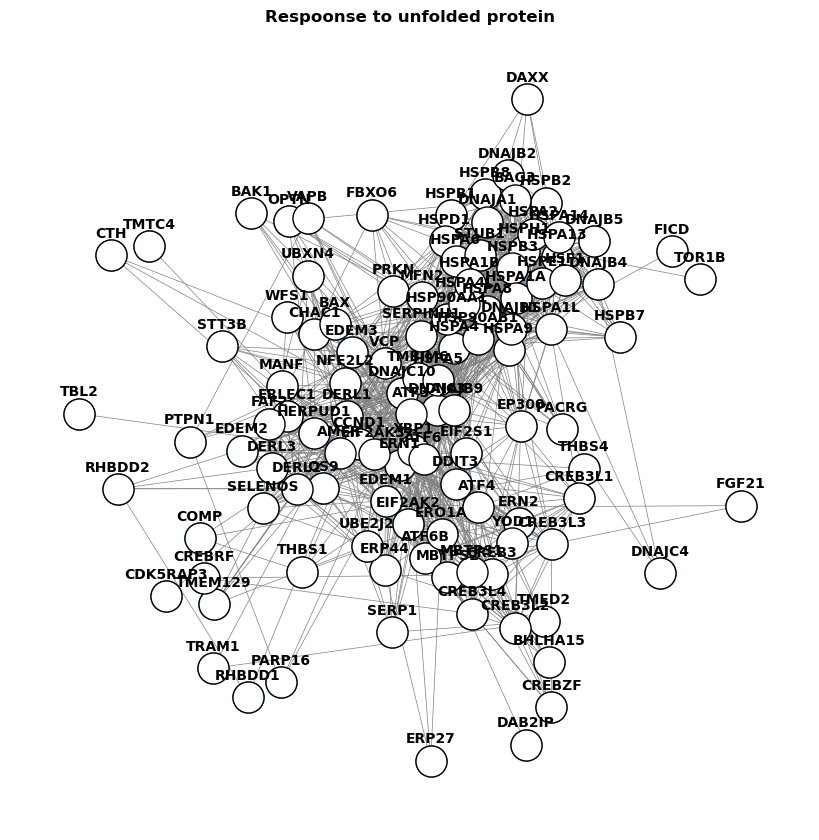

In [13]:
df = pd.read_csv('../../data/pathways/response_to_unfolded_protein.tsv', sep='\t')
node_list = list(set(df['#node1'].tolist() + df['node2'].tolist()))

vmax = max(markers_T_UNI_TNBC[markers_T_UNI_TNBC['gene'].isin(node_list)].max().loc['avg_log2FC'],
           markers_T_UNI_HER2[markers_T_UNI_HER2['gene'].isin(node_list)].max().loc['avg_log2FC'])

for cluster in range(5):
    pathway_plot_one_cluster(df, node_list, cluster, markers_T_UNI_HER2, vmax=1, seed=4, k=1)
    plt.title(f'Respoonse to unfolded protein -- HER2 cluster {cluster}', weight='bold')
    plt.savefig(os.path.join(config_HER2["figures_folder"], "Figure5", f'response_to_unfolded_protein_cluster{cluster}.pdf'), bbox_inches='tight')
    
for cluster in range(6):
    pathway_plot_one_cluster(df, node_list, cluster, markers_T_UNI_TNBC, vmax=1, seed=4, k=1)
    plt.title(f'Respoonse to unfolded protein -- TNBC cluster {cluster}', weight='bold')
    plt.savefig(os.path.join(config_TNBC["figures_folder"], "Figure5", f'response_to_unfolded_protein_cluster{cluster}.pdf'), bbox_inches='tight')

pathway_plot_one_cluster(df, node_list, 0, markers_T_UNI_TNBC, color=False)
plt.title('Respoonse to unfolded protein', weight='bold')
plt.savefig(os.path.join(config_TNBC["figures_folder"], "Figure5", 'response_to_unfolded_protein_overall.pdf'), bbox_inches='tight')

Text(0.5, 1.0, 'peptide_antigen_assembly_with_MHC_protein_complex ')

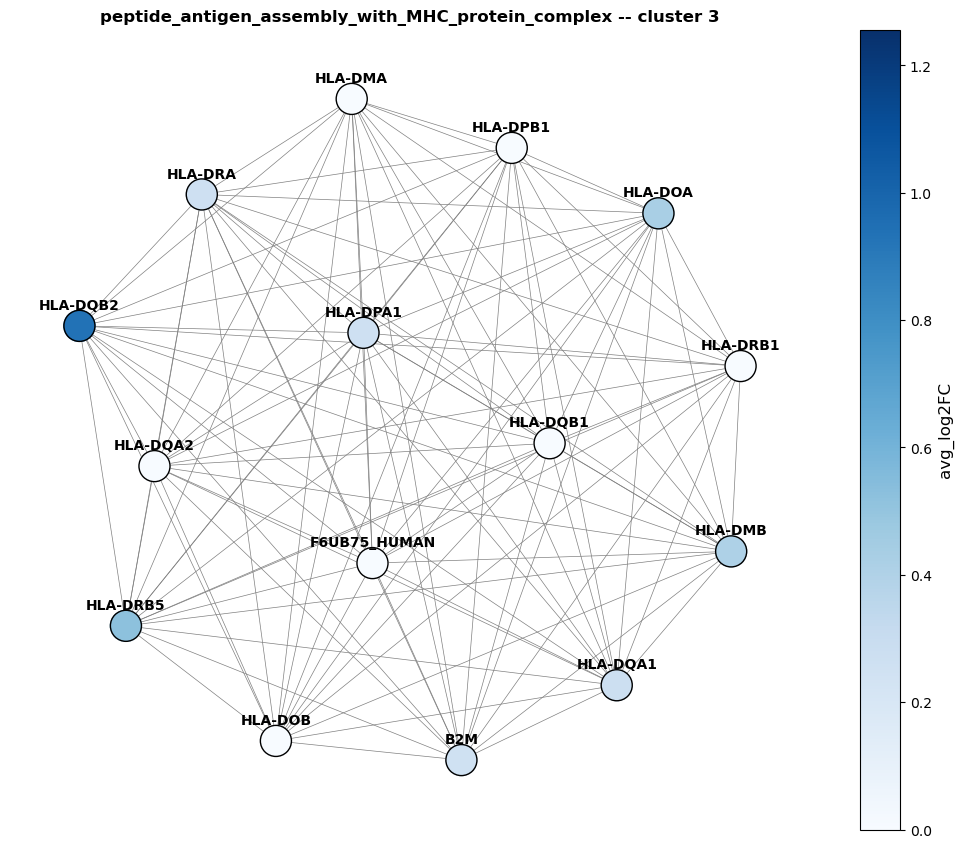

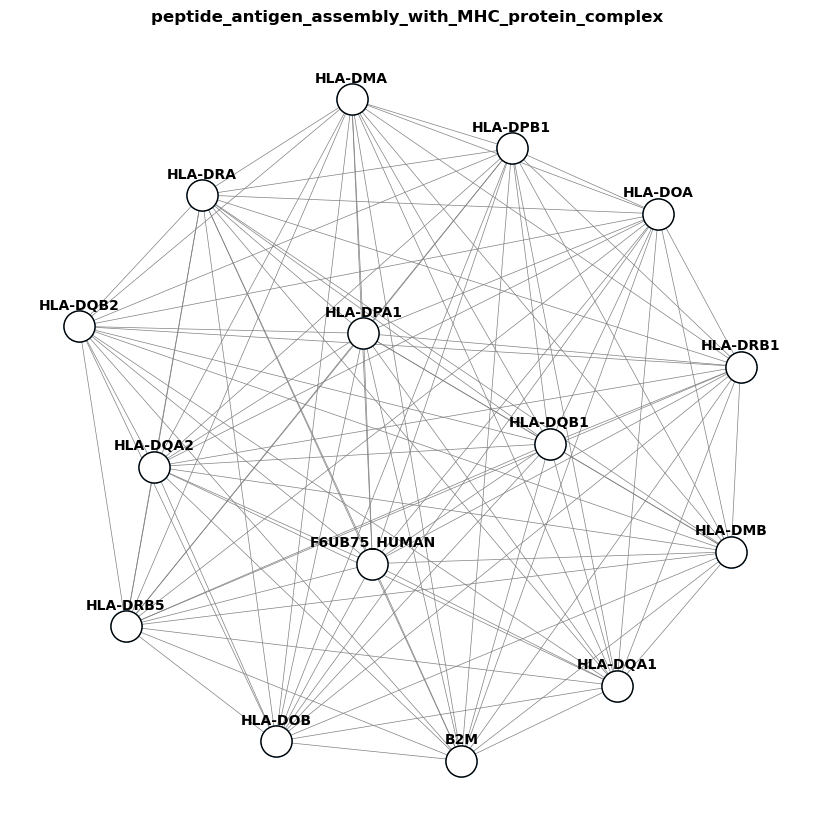

In [14]:
df = pd.read_csv('../../data/pathways/peptide_antigen_assembly_with_MHC_protein_complex.tsv', sep='\t')
node_list = list(set(df['#node1'].tolist() + df['node2'].tolist()))

vmax = markers_T_UNI_TNBC[markers_T_UNI_TNBC['gene'].isin(node_list)].max().loc['avg_log2FC']

pathway_plot_one_cluster(df, node_list, 3, markers_T_UNI_TNBC, vmax=vmax)
plt.title('peptide_antigen_assembly_with_MHC_protein_complex -- cluster 3', weight='bold')
plt.savefig(os.path.join(config_TNBC["figures_folder"], "Figure5", 'peptide_antigen_assembly_with_MHC_protein_complex_cluster3.pdf'), bbox_inches='tight')

pathway_plot_one_cluster(df, node_list, 0, markers_T_UNI_TNBC, color=False)
plt.title('peptide_antigen_assembly_with_MHC_protein_complex ', weight='bold')

# Pathways Exploration (Ovarian)

In [16]:
# Ovarian 
pathways = pd.read_csv("../../results/Ovarian/benchmark/uni_explora_models/invasive_cancer_clustering/kmeans/uni/upregulated_6_clusters_all_result_matrix_no_labels.csv", index_col=0)

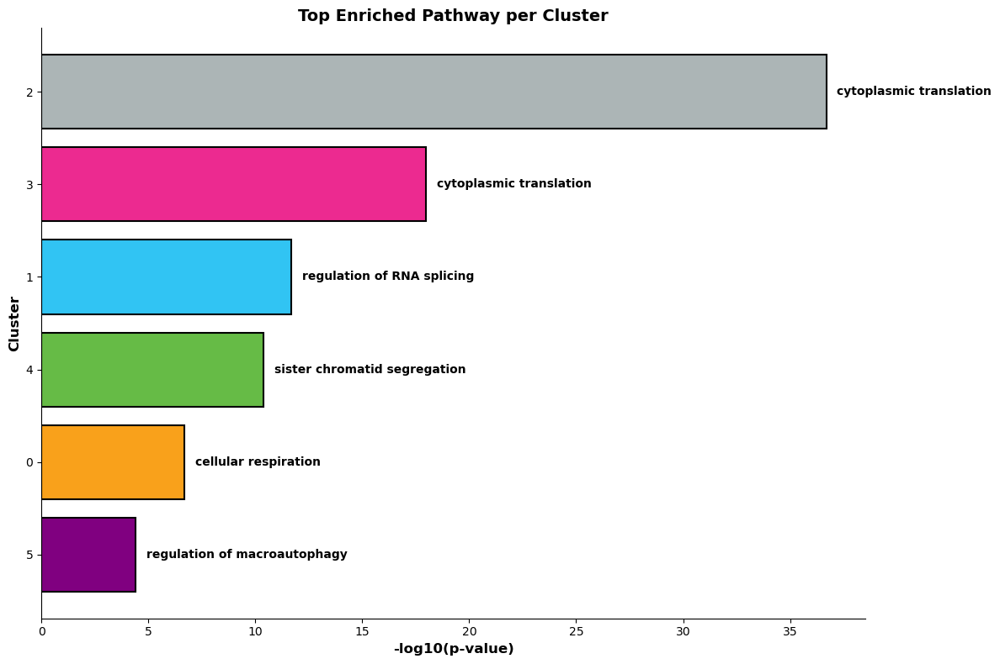

In [18]:
palette = {'0': '#F9A11B', '2': '#ACB5B6', '4': '#66BB46', '3': '#EC2A90', '1': '#31C4F3', '5': 'purple'}

# Get top pathway for each cluster
top_pathways = []
for col in pathways.columns:
    top_pathway = pathways[col].idxmax()
    top_value = pathways[col].max()
    top_pathways.append({
        'cluster': col,
        'pathway': top_pathway,
        'value': top_value,
        'color': palette[str(col)]
    })

df_top = pd.DataFrame(top_pathways)

# Sort by value in descending order
df_top = df_top.sort_values('value', ascending=True)  # ascending=True for horizontal bar (bottom to top)

# Create barplot
fig, ax = plt.subplots(figsize=(12, 8))
bars = ax.barh(df_top['cluster'].astype(str), df_top['value'], color=df_top['color'], edgecolor='black', linewidth=1.5)

# Add pathway names as text
for idx, row in df_top.iterrows():
    ax.text(row['value'] + 0.5, df_top.index.get_loc(idx), row['pathway'], va='center', fontsize=10, weight='bold')

ax.set_xlabel('-log10(p-value)', fontsize=12, fontweight='bold')
ax.set_ylabel('Cluster', fontsize=12, fontweight='bold')
ax.set_title('Top Enriched Pathway per Cluster', fontsize=14, fontweight='bold')
sns.despine()
plt.tight_layout()
plt.savefig("../../Figures/Ovarian/barplot_top_pathways_uni.pdf", bbox_inches='tight')
plt.show()